## Integration of all samples

### Packages:

In [1]:
%load_ext autoreload
%autoreload 2

from statsmodels.stats.multitest import multipletests
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
import random
import scipy
import os

mpl.rcParams['pdf.fonttype'] = 42

In [2]:
import sys

import anndata as ad
# from scipy import sparse

import seaborn as sns
import harmonypy as hm
# import scib_metrics as sb

import torch
from inVAE import FinVAE

from matplotlib.colors import ListedColormap, LinearSegmentedColormap

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
data_dir = '/lustre/scratch126/cellgen/team205/heart/objects/hypersampling/diseased/RNA/Reichart22/Reichart22.h5ad'

In [5]:
write_dir = '/lustre/scratch126/cellgen/team292/ha10/data/Heart_Atlas/'

In [6]:
# compute roc functions
from sklearn.metrics import roc_auc_score
def compute_roc(data,y,cell_type_column):
    roc = roc_auc_score(
        y_score=data[y].values,
        y_true=data[cell_type_column].values,
        labels=data[cell_type_column].unique(),
    )

    if roc < 0.5:
        roc = 1 - roc
    return roc

def compute_mean_roc(data,y,cell_type_column):
    from itertools import combinations
    combos = list(combinations(data[cell_type_column].unique(), 2))
    roc = np.mean(
        [
            compute_roc(data.loc[data[cell_type_column].isin(combo)],y,cell_type_column)
            for combo in combos
        ]
    )
    return roc

In [7]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from itertools import combinations
from sklearn.metrics import silhouette_score

def plot_density(
    ad,
    plot_basis="X_umap",
    save_as=None,
    show=True,
    color=None,
    palette=None,
    group=None,
    s=2
):
    """Plot archetype initialization.
    
    Parameters:
    ad (AnnData): AnnData containing 'Metacells' label in .obs.
    model: Initialized SEACells model.
    plot_basis (str): Basis for plotting (default is "X_umap").
    save_as (str): File path to save the plot (default is None).
    show (bool): Whether to display the plot (default is True).
    color (str): Column name for coloring points.
    palette: Custom color palette.
    group (str): Grouping column name.
    s (int): Size of points in the scatter plot.

    Returns:
    None
    """
    

    color_dic = {ad.obs[color].cat.categories[i]: ad.uns[color + '_colors'][i] for i in range(len(ad.obs[color].cat.categories))}

    pds = pd.DataFrame(ad.obsm[plot_basis].reshape(-1, 2), columns=['0', '1'])
    pds['categories'] = list(ad.obs[color])

    if group is not None:
        pds_group = pd.DataFrame(ad[ad.obs[group]].obsm[plot_basis].reshape(-1, 2), columns=['0', '1'])
        pds_group['categories'] = list(ad[ad.obs[group]].obs[color])
    else:
        pds_group = pds.copy()
        
    
    # compute roc
    roc = compute_mean_roc(pds_group,'1','categories')
    
    # compute silloutte
    silh = silhouette_score(
    X=pds_group[['0','1']].values.reshape(-1, 2),
    labels=pds_group['categories'].values)
    

    # Set up the JointGrid
    g = sns.JointGrid(data=pds_group, x='0', y='1', height=8)

    # KDE plot for density estimation
    sns.kdeplot(data=pds, x='0', y='1', fill=False, color="lightgray", ax=g.ax_joint, legend=False, palette=color_dic)

    # Scatter plot
    sns.scatterplot(data=pds_group, x='0', y='1', hue='categories', ax=g.ax_joint, palette=color_dic, legend=False, s=s, linewidth=0)#, legend='full'
    
    # Plot histogram on top (only for x dimension)
    for category, color in color_dic.items():
        if category in pds_group['categories'].unique():
            print(category,color,pds_group[pds_group['categories'] == category].shape)
            sns.distplot(pds_group[pds_group['categories'] == category]['0'], kde=True, ax=g.ax_marg_x, color=color, hist=False, kde_kws={'fill': True})
            sns.distplot(pds_group[pds_group['categories'] == category]['1'], kde=True, ax=g.ax_marg_y, vertical=True, color=color, hist=False, kde_kws={'fill': True})

    # Remove unused y-axis and grid lines
    # g.ax_marg_y.remove()
    # g.ax_marg_x.remove()
    g.ax_joint.grid(False)
    g.ax_marg_x.grid(False)
    
    # Remove axis lines
    # g.ax_joint.spines['top'].set_visible(False)
    # g.ax_joint.spines['right'].set_visible(False)
    g.ax_joint.spines['bottom'].set_visible(False)
    g.ax_joint.spines['left'].set_visible(False)
    
    # Remove ticks, labels, and numbers from the entire plot
    g.ax_marg_x.set_xticks([])
    g.ax_marg_x.set_yticks([])
    g.ax_marg_y.set_xticks([])
    g.ax_marg_y.set_yticks([])
    g.ax_joint.set_xticks([])
    g.ax_joint.set_yticks([])
    g.ax_joint.set_xlabel('')
    g.ax_joint.set_ylabel('')
    g.ax_marg_x.set_xlabel('')
    g.ax_marg_y.set_ylabel('')
    
    g.ax_joint.text(0.37, 1.0, f'Sil.: {silh:.2e}, ROC AUC: {roc:.2e}', transform=g.ax_joint.transAxes, fontsize=16, verticalalignment='top')
    
    plt.title=group
    # plt.legend(frameon=False) 
    

    if save_as is not None:
        plt.savefig(save_as)
    if show:
        plt.show()
    plt.close()


In [8]:
write_dir

'/lustre/scratch126/cellgen/team292/ha10/data/Heart_Atlas/'

In [9]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

def plot_densityWmetacells(
    ad,
    ad_seacell,
    plot_basis="X_umap",
    save_as=None,
    show=True,
    color=None,
    palette=None,
    group=None,
    s=2
):
    """Plot archetype initialization.
    
    Parameters:
    ad (AnnData): AnnData containing 'Metacells' label in .obs.
    ad_seacell: Initialized SEACells model.
    plot_basis (str): Basis for plotting (default is "X_umap").
    save_as (str): File path to save the plot (default is None).
    show (bool): Whether to display the plot (default is True).
    color (str): Column name for coloring points.
    palette: Custom color palette.
    group (str): Grouping column name.
    s (int): Size of points in the scatter plot.

    Returns:
    None
    """
    
    umap = pd.DataFrame(ad.obsm[plot_basis]).set_index(ad.obs_names).join(ad.obs["SEACell"])
    umap["SEACell"] = umap["SEACell"].astype("category")
    mcs = umap.groupby("SEACell").mean()
    mcs.index = [x[8:] for x in mcs.index]
    
    mcs['celltype'] = list(ad_seacell[mcs.index].obs['celltype'])
    mcs['celltype_purity'] = list(ad_seacell[mcs.index].obs['celltype_purity'])
    
    color_dic = {ad.obs[color].cat.categories[i]: ad.uns[color + '_colors'][i] for i in range(len(ad.obs[color].cat.categories))}

    pds = pd.DataFrame(ad.obsm[plot_basis].reshape(-1, 2), columns=['0', '1'])
    pds['categories'] = list(ad.obs[color])

    if group is not None:
        pds_group = pd.DataFrame(ad[ad.obs[group]].obsm[plot_basis].reshape(-1, 2), columns=['0', '1'])
        pds_group['categories'] = list(ad[ad.obs[group]].obs[color])
    else:
        pds_group = pds.copy()

    # Create the plot
    fig, ax = plt.subplots()

    # Plot the data with scatter plot
    sns.scatterplot(
        x=0, y=1, color="lightgrey", data=umap, s=s, linewidth=0, legend=None, ax=ax)

    scatter = sns.scatterplot(
        data=mcs,
        x=0,
        y=1,
        size="celltype_purity",
        hue='celltype',
        palette=color_dic,
        s=5,
        linewidth=0,
        ax=ax,
    )

    # Remove axes
    ax.axis('off')

    # Create a legend for the size outside the plot with empty circles
    legend = plt.legend(loc='center left', bbox_to_anchor=(1, 0.5),frameon=False)
    

    # Save or show the plot
    if save_as:
        plt.savefig('./figures/'+save_as, bbox_inches='tight')
    if show:
        plt.show()

In [10]:
def plot_box_with_pvalue(data,x,y,gene,desired_order,colors_dict):

    plotting_parameters = {
        'data':    data,
        'x':       x,
        'y':       y,
        # 'palette': subcat_palette[1:]
    }
    # Calculate p-values for each pair of consecutive time points
    p_values = []
    
    # Convert 'new_celltype' column to categorical with desired order
    data[x] = pd.Categorical(data[x], categories=desired_order, ordered=True)

    # Sort the DataFrame based on the categorical 'new_celltype' column
    data = data.sort_values(by=x)
    
    time_points = data[x].unique()
    for i in range(len(time_points) - 1):
        sample1 = data[data[x] == time_points[i]][y]
        sample2 = data[data[x] == time_points[i+1]][y]
        _, p = ttest_ind(sample1, sample2, equal_var=False)
        p_values.append(p)

    # Prepare pairs for annotator
    pairs = [(time_points[i], time_points[i+1]) for i in range(len(time_points) - 1)]

    # Transform each p-value to "p=" in scientific notation
    formatted_pvalues = [f'p={pvalue:.2e}' for pvalue in p_values]

    with sns.plotting_context('notebook', font_scale = 1.4):
        # Create new plot
        ax = get_log_ax(gene)
        
        # Plot with seaborn
        sns.boxplot(**plotting_parameters,palette=colors_dict)
        
        # Remove top and right border of the axis
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        sns.despine()
        
        
        # Add annotations
        annotator = Annotator(ax, pairs, **plotting_parameters)
        annotator.set_custom_annotations(formatted_pvalues)
        annotator.annotate()

        # Label and show
        label_plot_for_subcats(ax,gene)
        plt.show()

    plt.show()

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import ttest_ind
from statannotations.Annotator import Annotator
import seaborn as sns
import scipy.stats as sci_stats

def label_plot_for_subcats(ax,gene):
    plt.title(gene, y=1.06)
    ax.set_ylabel("expression (log+1)")
    # ax.set_xlabel("cell type", labelpad=20)

def get_log_ax(label_plot_for_subcats,orient="v"):
    if orient == "v":
        figsize = (6, 6)
        set_scale = "set_yscale"
    else:
        figsize = (6, 6)
        set_scale = "set_xscale"
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    fig.patch.set_alpha(1)
    getattr(ax, set_scale)("log")
    return ax    

def plot_box_with_pvalue(data,x,y,gene,desired_order,colors_dict,save=None):

    plotting_parameters = {
        'data':    data,
        'x':       x,
        'y':       y,
        # 'palette': subcat_palette[1:]
    }
    # Calculate p-values for each pair of consecutive time points
    p_values = []
    
    # Convert 'new_celltype' column to categorical with desired order
    data[x] = pd.Categorical(data[x], categories=desired_order, ordered=True)

    # Sort the DataFrame based on the categorical 'new_celltype' column
    data = data.sort_values(by=x)
    
    time_points = data[x].unique()
    for i in range(len(time_points) - 1):
        sample1 = data[data[x] == time_points[i]][y]
        sample2 = data[data[x] == time_points[i+1]][y]
        _, p = ttest_ind(sample1, sample2, equal_var=False)
        p_values.append(p)

    # Prepare pairs for annotator
    pairs = [(time_points[i], time_points[i+1]) for i in range(len(time_points) - 1)]

    # Transform each p-value to "p=" in scientific notation
    formatted_pvalues = [f'p={pvalue:.2e}' for pvalue in p_values]

    with sns.plotting_context('notebook', font_scale = 1.4):
        # Create new plot
        ax = get_log_ax(gene)
        
        # Plot with seaborn
        sns.boxplot(**plotting_parameters,palette=colors_dict)
        
        # Remove top and right border of the axis
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        sns.despine()
        
        
        # Add annotations
        annotator = Annotator(ax, pairs, **plotting_parameters)
        annotator.set_custom_annotations(formatted_pvalues)
        annotator.annotate()

        # Label and show
        label_plot_for_subcats(ax,gene)
        # plt.show()
    if save:
        plt.savefig('./figures/'+save)

    plt.show()


ModuleNotFoundError: No module named 'statannotations'

In [12]:
adata= sc.read(write_dir+'adata_heart_Reichart_25_5_noAge_noSex_varMean_filtered_reproduce.h5ad')

In [13]:
adata

AnnData object with n_obs × n_vars = 284727 × 5000
    obs: 'Sample', 'donor_id', 'Region_x', 'Primary.Genetic.Diagnosis', 'n_genes', 'n_counts', 'percent_mito', 'percent_ribo', 'scrublet_score_z', 'scrublet_score_log', 'solo_score', 'cell_states', 'Assigned', 'self_reported_ethnicity_ontology_term_id', 'disease_ontology_term_id', 'cell_type_ontology_term_id', 'sex_ontology_term_id', 'assay_ontology_term_id', 'organism_ontology_term_id', 'is_primary_data', 'tissue_ontology_term_id', 'development_stage_ontology_term_id', 'suspension_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'disease_renamed'
    var: 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'ENS'
    uns: 'Primary.Genetic.Diagnosis_colors', 'Region_x_colors', 'cell_states_colors', 'cell_type_colors', 'cell_type_ontology_term_id_colors', 'diseas

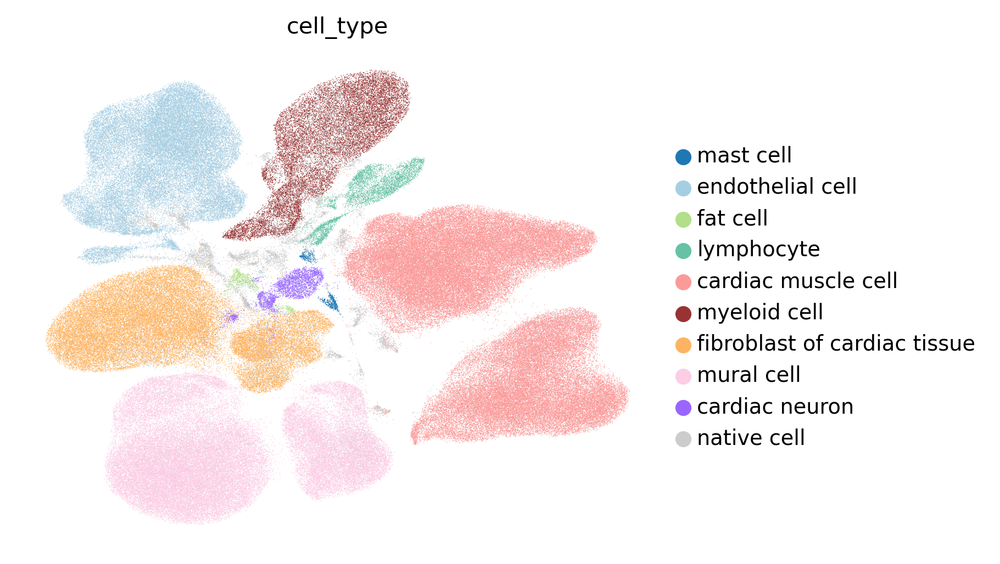

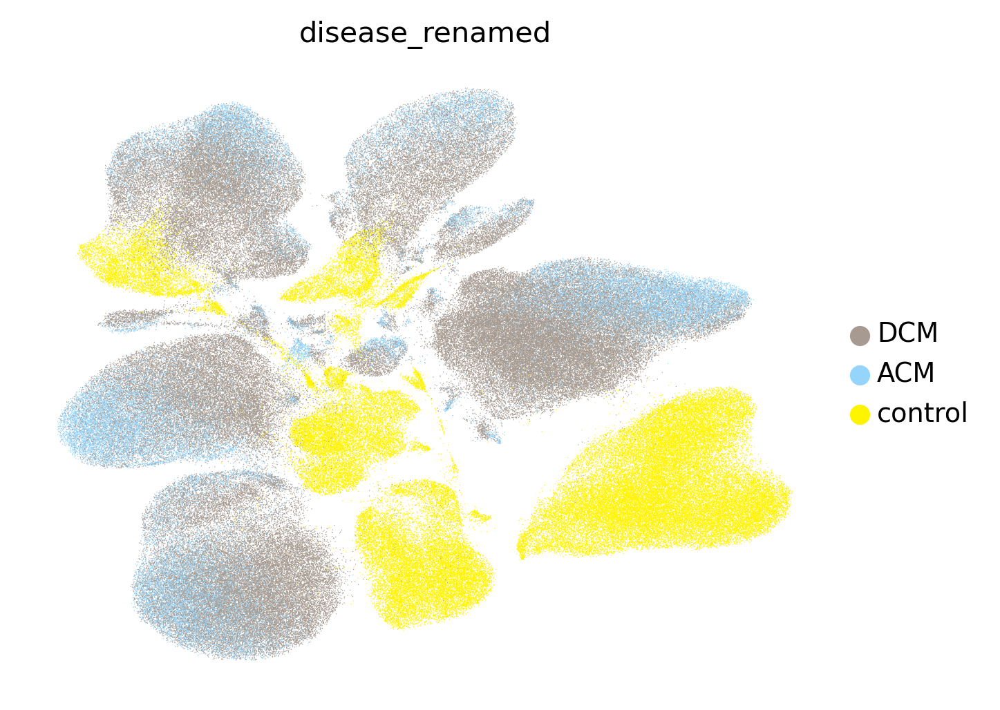

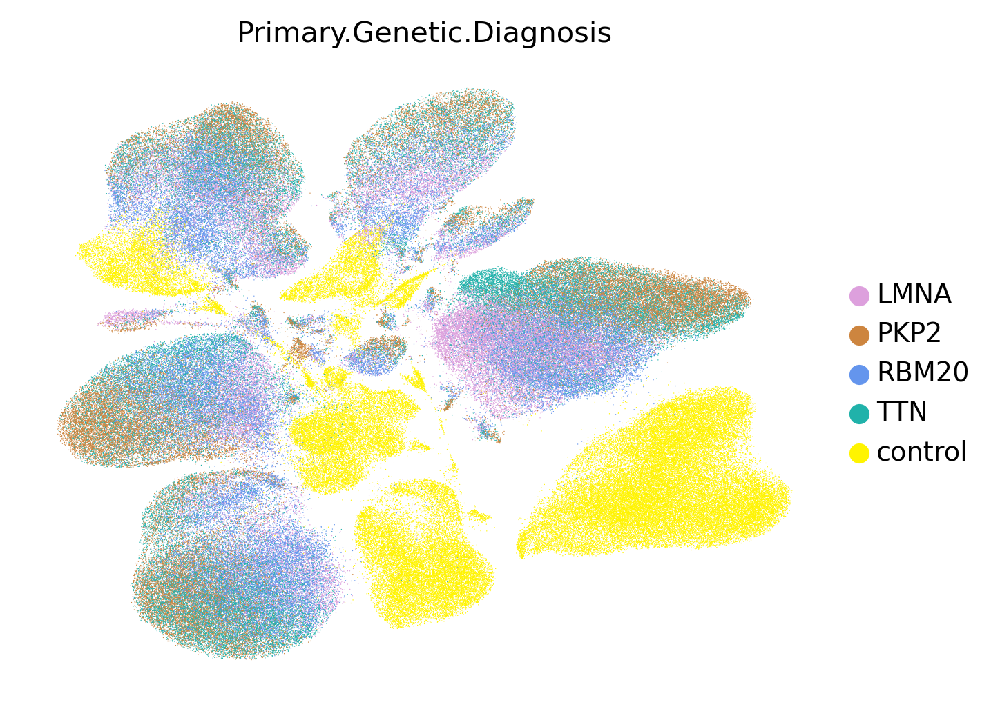

In [26]:
sc.set_figure_params(dpi=150,figsize=(5,4),fontsize=10,frameon=False)
sc.pl.umap(adata,color='cell_type',save='heart_atlas_cell_type.pdf')
sc.pl.umap(adata,color='disease_renamed',palette= ['#a79b91','#95d5fc','#fff400'],save='heart_atlas_disease.pdf')
sc.pl.umap(adata,color='Primary.Genetic.Diagnosis',palette=['plum','peru','cornflowerblue','lightseagreen','#fff400'],save='heart_atlas_variant.pdf')

In [13]:
test = adata.raw.to_adata()
sc.pp.normalize_per_cell(test)
sc.pp.log1p(test)
test.var_names = test.var['feature_name']

In [14]:
adata.raw = test
del test

In [15]:
adata.obs.disease_renamed.unique()

['DCM', 'control', 'ACM']
Categories (3, object): ['DCM', 'ACM', 'control']

In [17]:
adata_fibro = adata[adata.obs.cell_type=='fibroblast of cardiac tissue'].copy()
test = adata_fibro.raw.to_adata()
sc.pp.normalize_per_cell(test)
sc.pp.log1p(test)
adata_fibro.raw= test.copy()
del test

In [21]:
#del adata

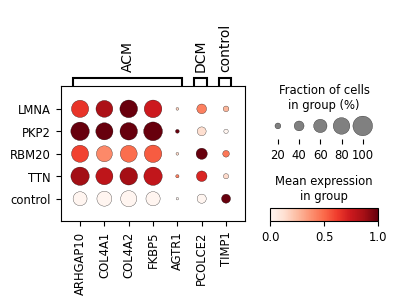

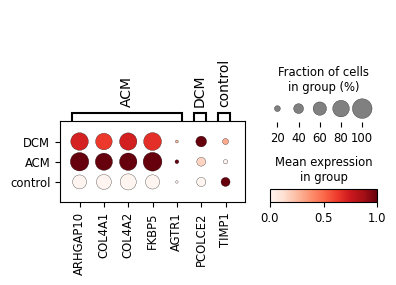

In [18]:
top_genes = {'ACM':['ARHGAP10','COL4A1', 'COL4A2','FKBP5', 'AGTR1'],'DCM':['PCOLCE2'], 'control':['TIMP1']} #XIRP1/2, ANKRD1, or ACTA1

sc.pl.dotplot(adata_fibro,var_names=top_genes,groupby='Primary.Genetic.Diagnosis',mean_only_expressed=False, standard_scale='var',use_raw=True,save='heart_fibro_genes_variants.pdf')
# sc.pl.dotplot(adata_fibro_LV,var_names=['FKBP5', 'AGTR1','PCOLCE2','TIMP1','ARHGAP10','COL4A1', 'COL4A2'],groupby='Primary.Genetic.Diagnosis',mean_only_expressed=False, standard_scale='var',use_raw=True)
# sc.pl.dotplot(adata_fibro_RV,var_names=['FKBP5', 'AGTR1','PCOLCE2','TIMP1','ARHGAP10','COL4A1', 'COL4A2'],groupby='Primary.Genetic.Diagnosis',mean_only_expressed=False, standard_scale='var',use_raw=True)


sc.pl.dotplot(adata_fibro,var_names=top_genes,groupby='disease_renamed',mean_only_expressed=False, standard_scale='var',use_raw=True,save='heart_fibro_genes_disease.pdf')

In [18]:
sc.pp.neighbors(adata_fibro, use_rep='X_FinVAE_25_5',n_neighbors=20, key_added='neighbors_FinVAE_25_5')
sc.tl.leiden(adata_fibro,neighbors_key='neighbors_FinVAE_25_5')
sc.tl.leiden(adata_fibro,neighbors_key='neighbors_FinVAE_25_5',resolution=0.15,key_added='leiden_015')

In [32]:
del adata_fibro.uns['Primary.Genetic.Diagnosis_colors']

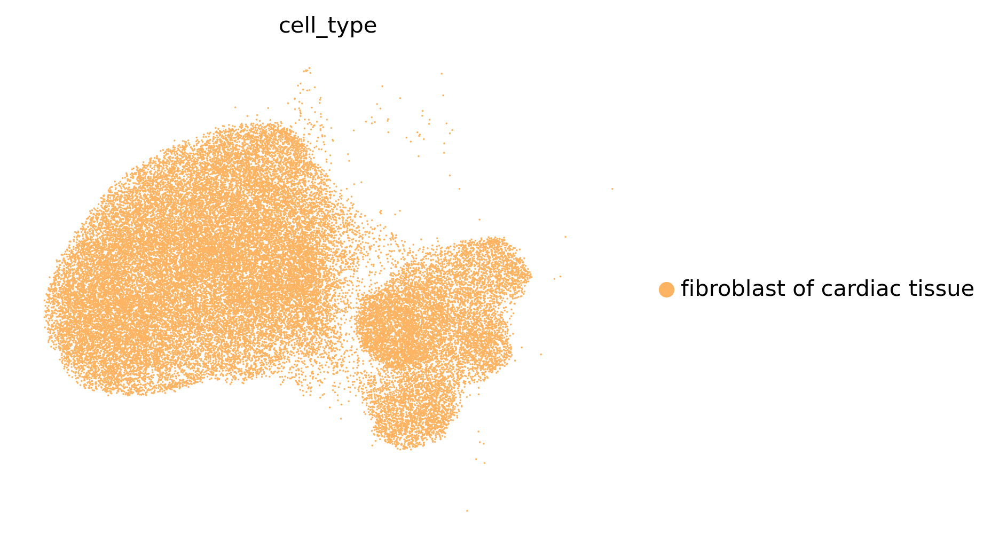

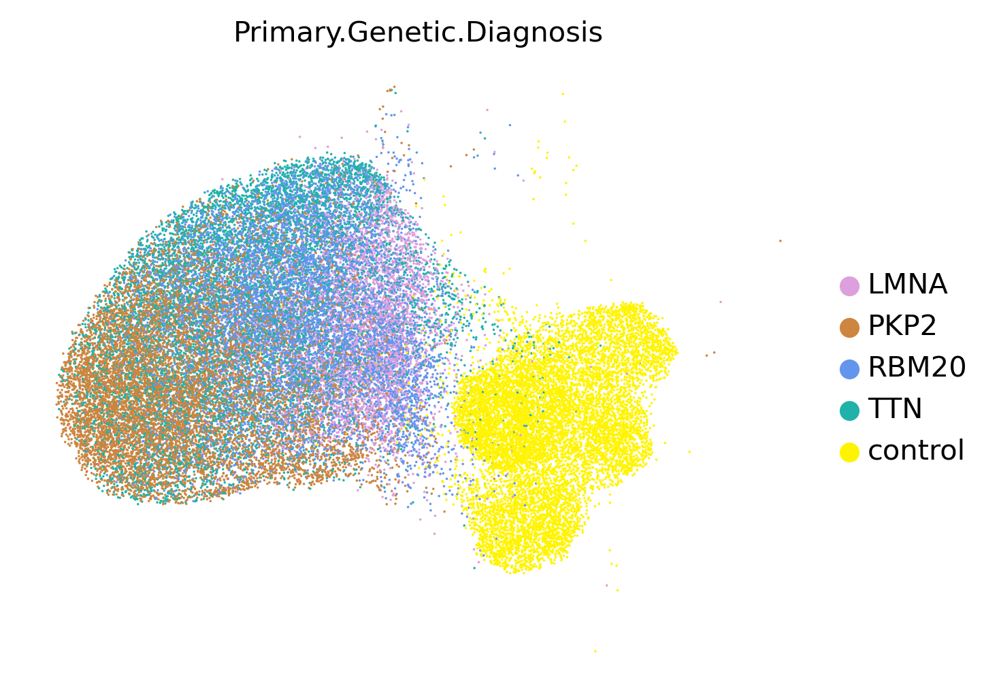

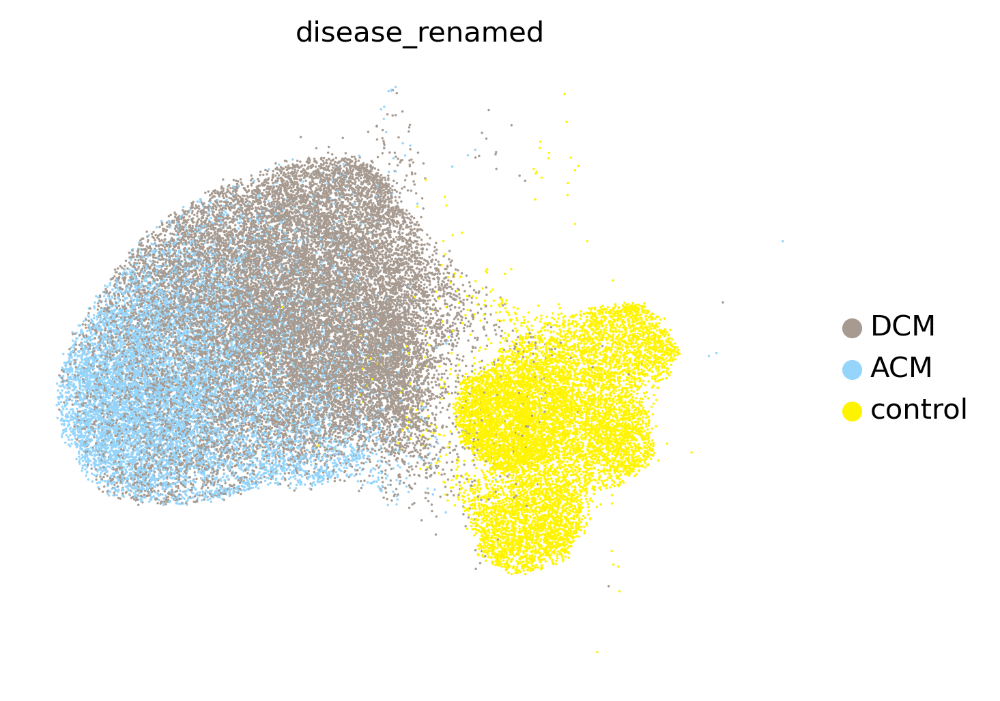

In [33]:
sc.set_figure_params(dpi=150,figsize=(5,4),fontsize=10,frameon=False)
sc.pl.umap(adata_fibro,color=['cell_type'],use_raw=True,legend_fontsize=10,save='heart_fibro_cell_type.pdf')
sc.pl.umap(adata_fibro,color=['Primary.Genetic.Diagnosis'],use_raw=True,legend_fontsize=10,palette=['plum','peru','cornflowerblue','lightseagreen','#fff400'],save='heart_fibro_variants.pdf')
sc.pl.umap(adata_fibro,color=['disease_renamed'],use_raw=True,legend_fontsize=10,save='heart_fibro_disease_renamed.pdf')

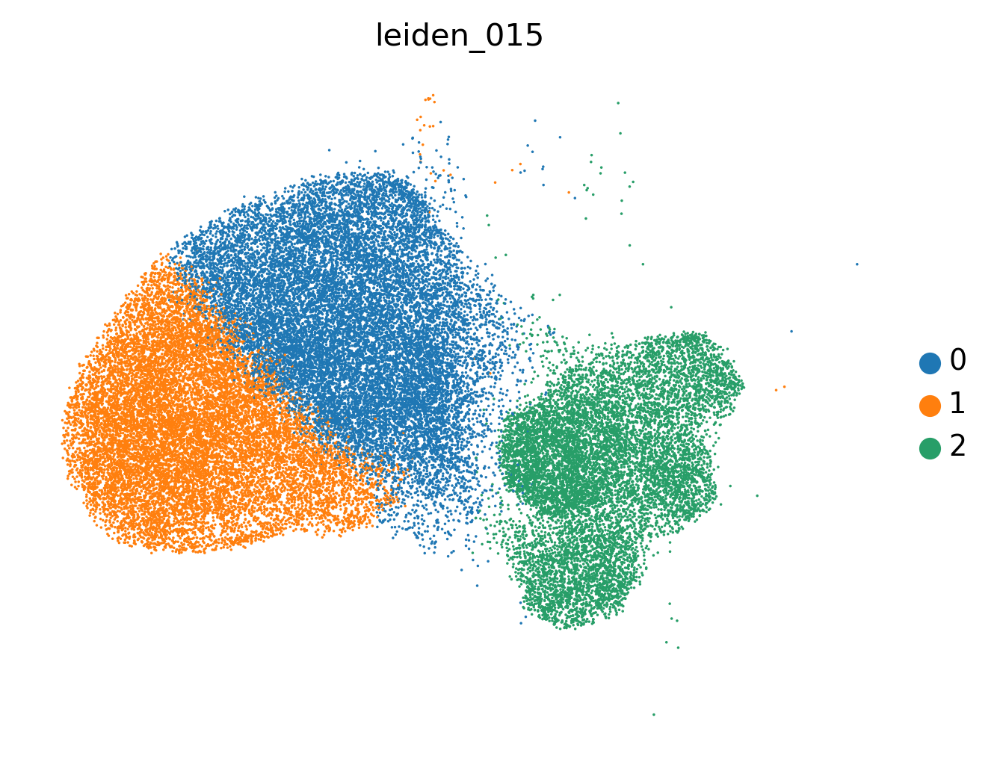

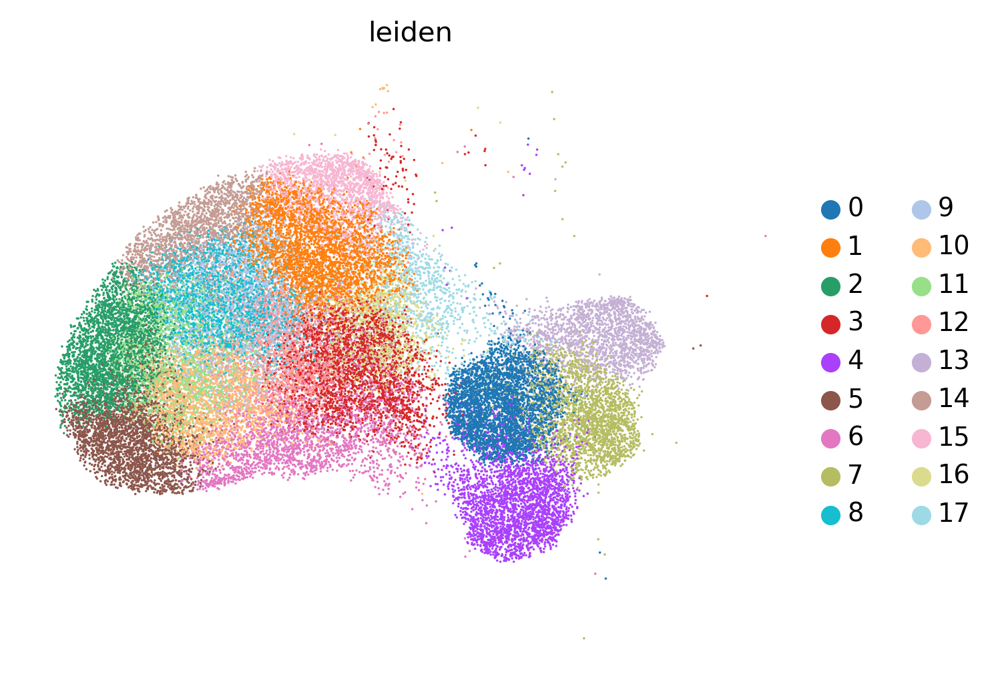

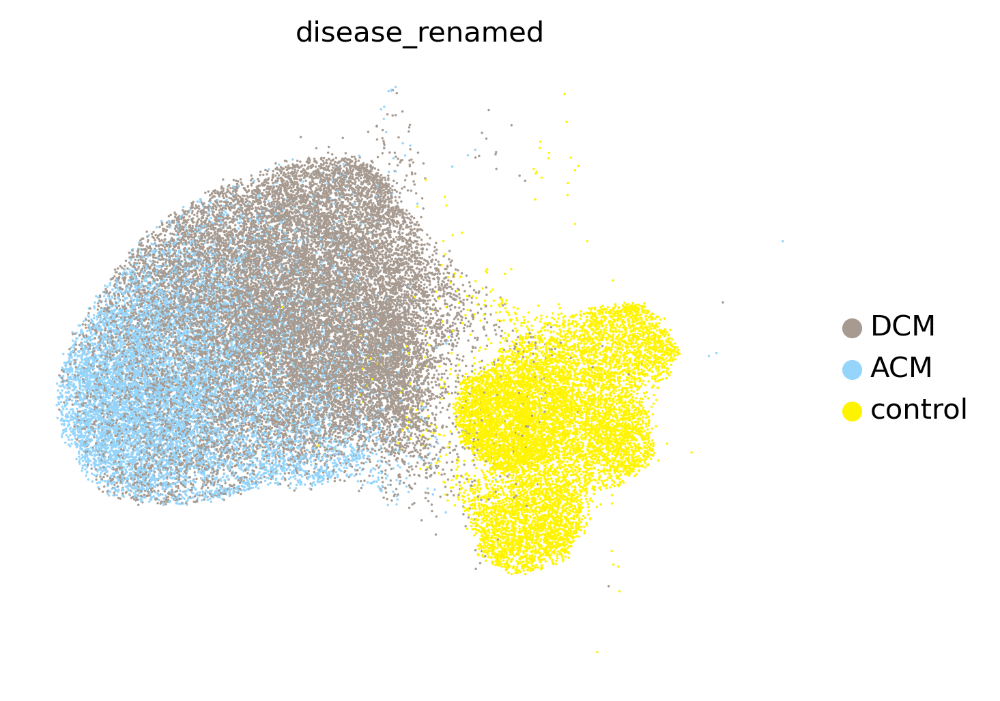

In [25]:
sc.set_figure_params(dpi=150,figsize=(5,4),fontsize=10,frameon=False)
sc.pl.umap(adata_fibro,color = ['leiden_015'])
sc.pl.umap(adata_fibro,color = ['leiden'])
sc.pl.umap(adata_fibro,color = ['disease_renamed'],legend_fontsize=10,palette= ['#a79b91','#95d5fc','#fff400',])

In [27]:
adata_fibro.obs['disease_new'] = adata_fibro.obs['disease_renamed'].astype(str)
adata_fibro.obs.loc[adata_fibro[(adata_fibro.obs.disease_renamed=='DCM') & (adata_fibro.obs.leiden_015=='1')].obs_names,'disease_new'] = 'ACM_like'

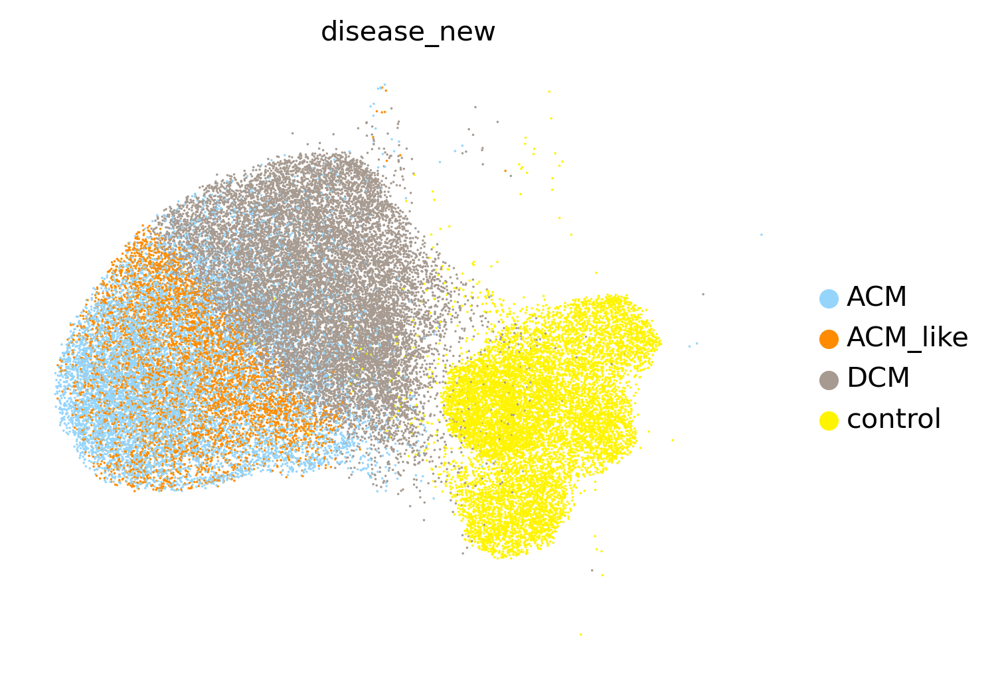

In [30]:
sc.pl.umap(adata_fibro,color = ['disease_new'],palette= ['#95d5fc','darkorange','#a79b91','#fff400'],legend_fontsize=10,save='heart_fibro_disease_new.pdf')

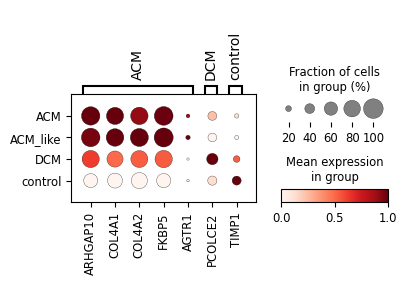

In [23]:
sc.pl.dotplot(adata_fibro,var_names=top_genes,groupby='disease_new',mean_only_expressed=False, standard_scale='var',use_raw=True,save='heart_fibro_genes_disease_new.pdf')


p-value annotation legend:
      ns: 5.00e-02 < p <= 1.00e+00
       *: 1.00e-02 < p <= 5.00e-02
      **: 1.00e-03 < p <= 1.00e-02
     ***: 1.00e-04 < p <= 1.00e-03
    ****: p <= 1.00e-04

ACM vs. ACM_like: p=3.77e-01
ACM_like vs. DCM: p=0.00e+00
DCM vs. control: p=0.00e+00


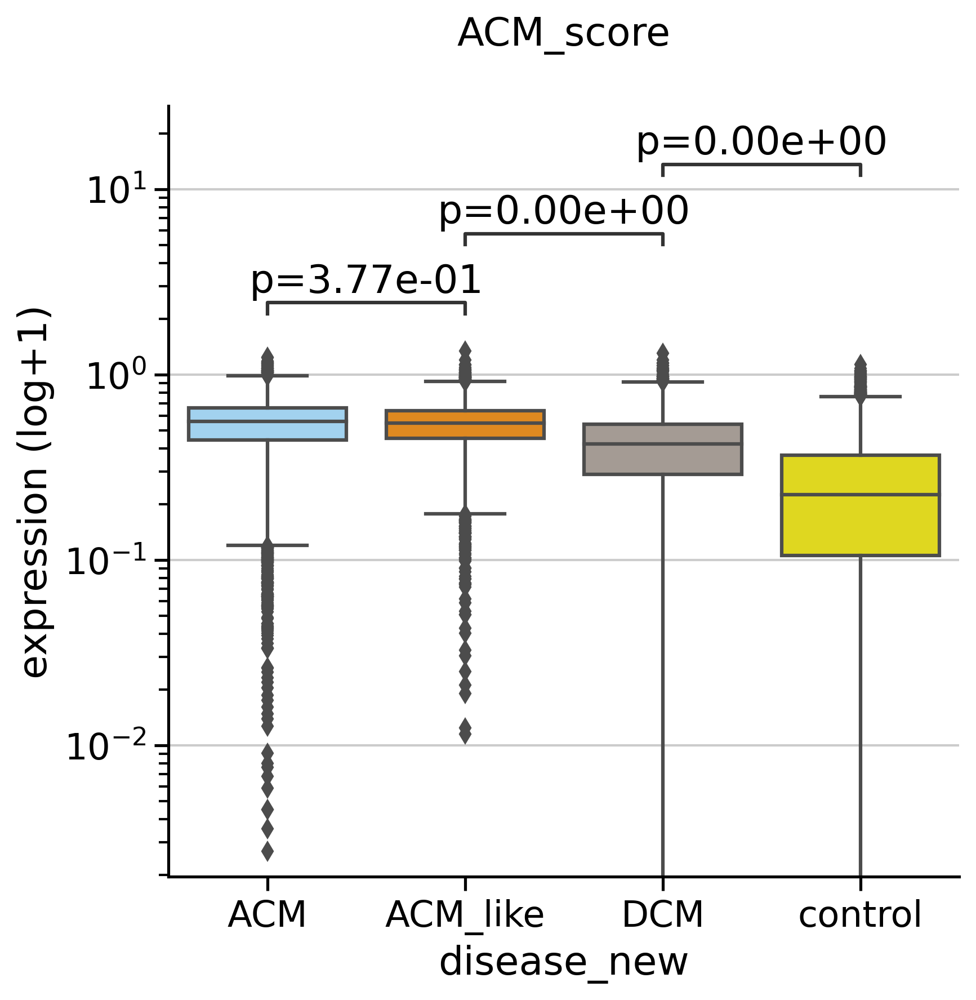

In [36]:
# sc.tl.score_genes(adata_fibro, ['ARHGAP10','COL4A1', 'COL4A2','FKBP5', 'AGTR1'], score_name='disease_score',use_raw=True)
# sc.tl.score_genes(adata_fibro, ['NPPB','ACTA1'], score_name='DCM_score',use_raw=True)
# sc.tl.score_genes(adata_fibro, ['MYH6'], score_name='control_score',use_raw=True)
sc.tl.score_genes(adata_fibro, ['ARHGAP10','COL4A1', 'COL4A2','FKBP5', 'AGTR1'], score_name='ACM_score',use_raw=True)
colors_dict = {'LMNA': '#8c564b', 'PKP2': '#e377c2', 'control': '#c49c94','RBM20':'#aec7e8','TTN':'#c5b0d5'}
colors_dict = ['#95d5fc','darkorange','#a79b91','#fff400']
# sc.pl.umap(adata_cardio_all,color='cardio_score')
# sc.pl.umap(adata_cardio_all,color='LMNA_score')
# sc.pl.umap(adata_cardio_all,color='control_score')
# sc.pl.umap(adata_cardio_all,color='PKP2_score')

# plot_box_with_pvalue(adata_fibro.obs,'disease_new','disease_score', 'disease_score',['ACM','ACM_like','DCM','control'],colors_dict) #,save='conduction_score_barplot.pdf')
# plot_box_with_pvalue(adata_fibro.obs,'disease_new','DCM_score', 'DCM_score',['ACM','ACM_like','DCM','control'],colors_dict) #,save='conduction_score_barplot.pdf')
# plot_box_with_pvalue(adata_fibro.obs,'disease_new','control_score', 'control_score',['ACM','ACM_like','DCM','control'],colors_dict) #,save='conduction_score_barplot.pdf')
plot_box_with_pvalue(adata_fibro.obs,'disease_new','ACM_score', 'ACM_score',['ACM','ACM_like','DCM','control'],colors_dict,save='heart_fibro_ACM_score.pdf')

In [23]:
import scanpy as sc
import pandas as pd
import matplotlib.pyplot as plt


def Barplot(which_var, adata, filename_suffix=None, var='lineage', height=3, color=False, lgd_hoffset=1., lgd_voffset=1., lgd_loc='center left', hide_spines=False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)

    ax1.legend(bbox_to_anchor=(lgd_hoffset, lgd_voffset), loc=lgd_loc)
    if hide_spines:
        ax1.spines['top'].set_visible(False)
        ax1.spines['right'].set_visible(False)
        ax1.spines['bottom'].set_visible(True)
        ax1.spines['left'].set_visible(False)
        
    ax1.set_xlim(0,100)   
        
    if filename_suffix is not None:
        ax1.figure.savefig(str(sc.settings.figdir)+f'/barplot_{var}_proportions_{which_var}_{filename_suffix}.pdf', bbox_inches='tight',
                           dpi=300, orientation='landscape', format= 'pdf')
    else:
        ax1.figure.savefig(str(sc.settings.figdir)+f'/barplot_{var}_proportions_{which_var}.pdf', bbox_inches='tight',
                           dpi=300, orientation='landscape', format= 'pdf')
    
    return ax1

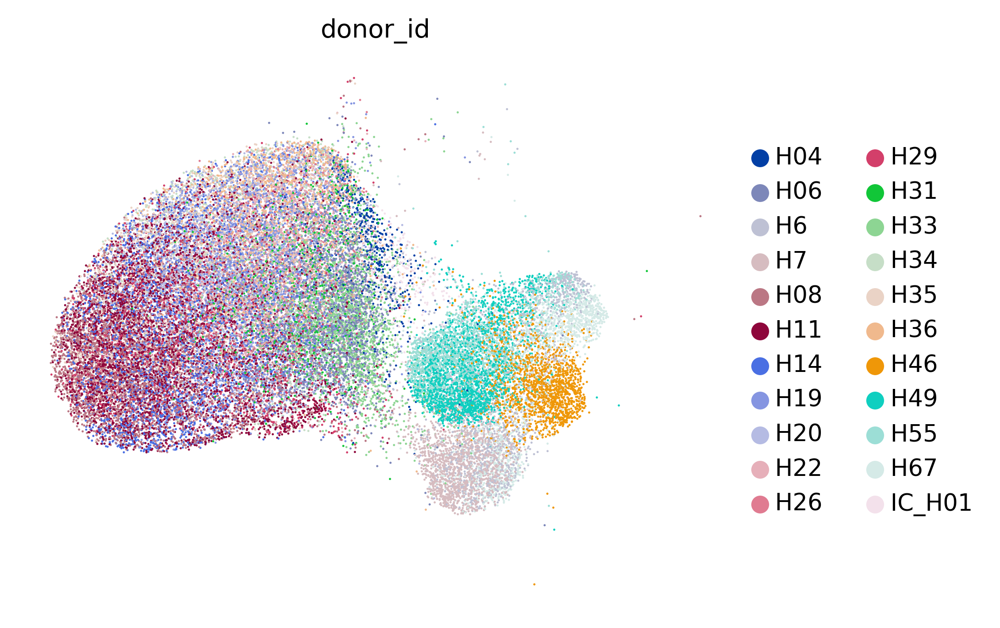

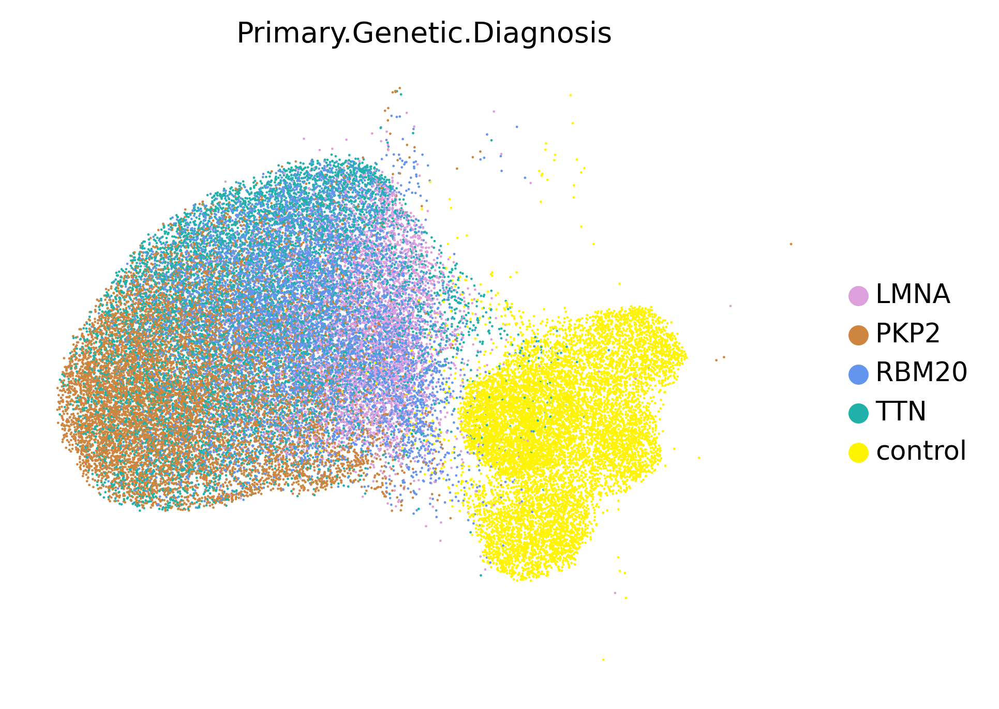

In [19]:
sc.set_figure_params(dpi=200,figsize=(5,4),fontsize=10,frameon=False)
sc.pl.umap(adata_fibro,color='donor_id')
sc.pl.umap(adata_fibro,color='Primary.Genetic.Diagnosis',palette=['plum','peru','cornflowerblue','lightseagreen','#fff400'],save='heart_fibro_variants.pdf')

<Axes: title={'center': 'donor_id %'}, ylabel='disease_new'>

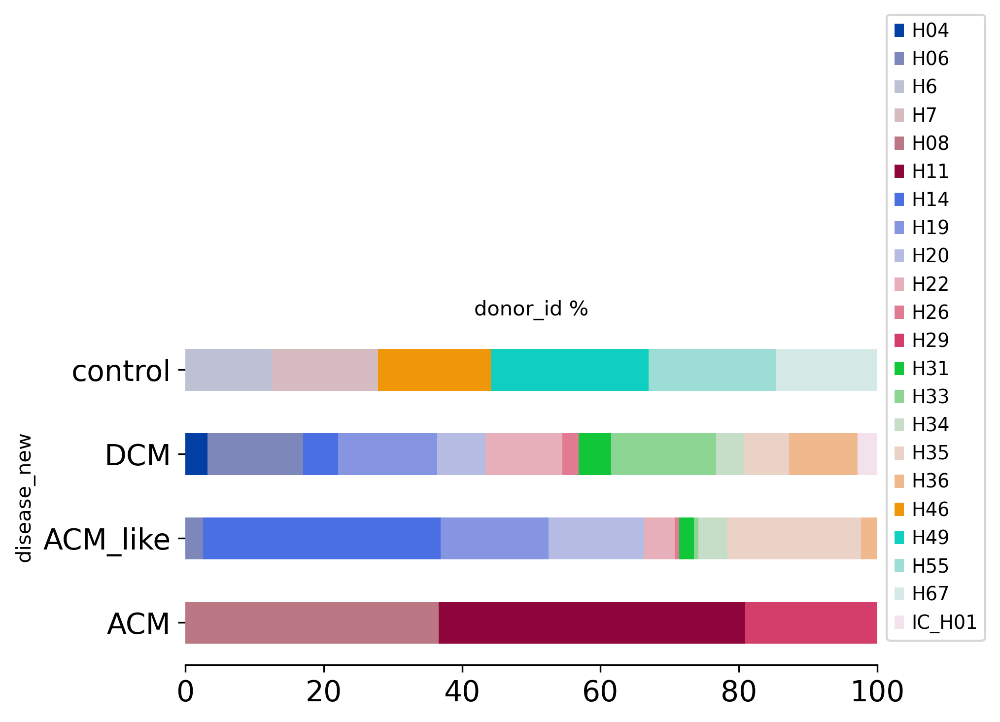

In [34]:
Barplot('donor_id', adata_fibro, var='disease_new', height=3, color=adata_fibro.uns['donor_id_colors'], lgd_hoffset=1., lgd_voffset=1., lgd_loc='center left', hide_spines=True,filename_suffix='heart_fibro_donor_composition_disease_new.pdf')

In [34]:
adata_fibro.uns['Primary.Genetic.Diagnosis_colors']

['#dda0dd', '#cd853f', '#6495ed', '#20b2aa', '#fff400']

<Axes: title={'center': 'Primary.Genetic.Diagnosis %'}, ylabel='disease_new'>

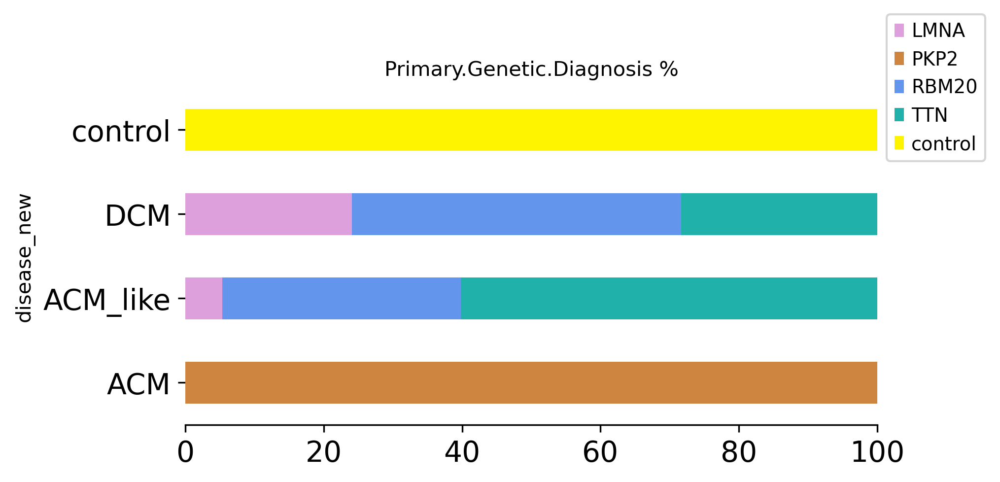

In [35]:
Barplot('Primary.Genetic.Diagnosis', adata_fibro, var='disease_new', height=3, color=['#dda0dd', '#cd853f', '#6495ed', '#20b2aa', '#fff400'], lgd_hoffset=1., lgd_voffset=1., lgd_loc='center left', hide_spines=True,filename_suffix='heart_fibro_variant_composition_disease_new.pdf')

<Axes: title={'center': 'donor_id %'}, ylabel='leiden'>

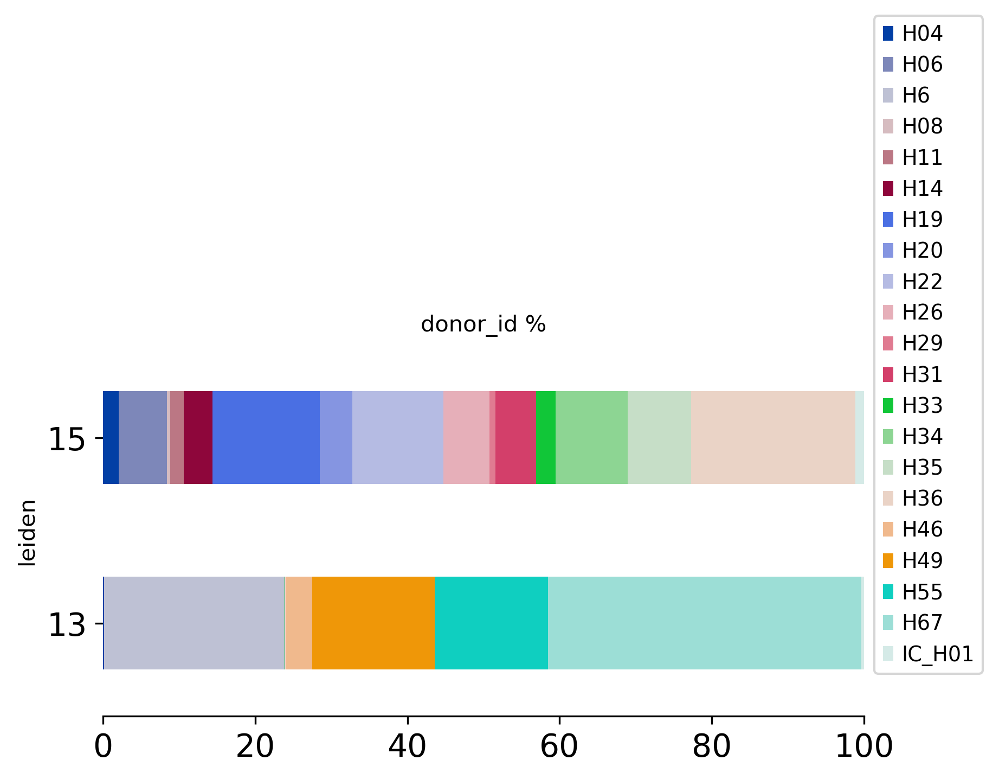

In [36]:
Barplot('donor_id', adata_fibro[adata_fibro.obs.leiden.isin(['13','15'])], var='leiden', height=3, color=adata_fibro.uns['donor_id_colors'], lgd_hoffset=1., lgd_voffset=1., lgd_loc='center left', hide_spines=True,filename_suffix='heart_fibro_donor_composition_activated_fibro.pdf')


In [76]:
adata_fibro.write(write_dir+'adata_fibro_processed.h5ad')

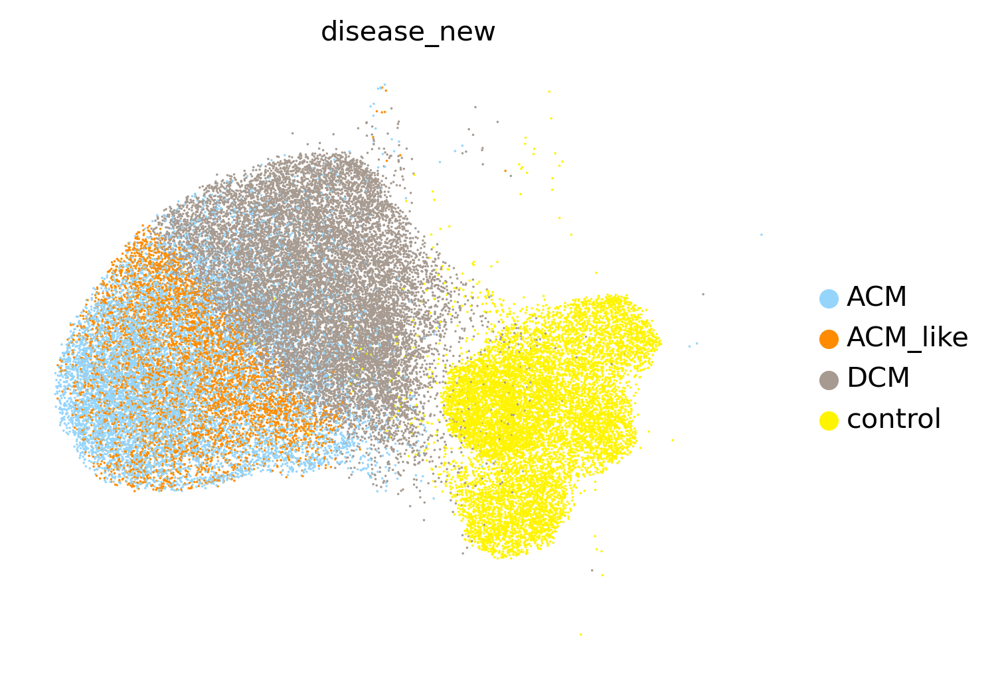

In [11]:
sc.set_figure_params(dpi=150,figsize=(5,4),fontsize=10,frameon=False)
adata_fibro = sc.read(write_dir+'adata_fibro_processed.h5ad')
sc.pl.umap(adata_fibro,color = ['disease_new'],legend_fontsize=10,palette= ['#95d5fc','darkorange','#a79b91','#fff400']
           ,save='heart_fibro_disease_new.pdf')

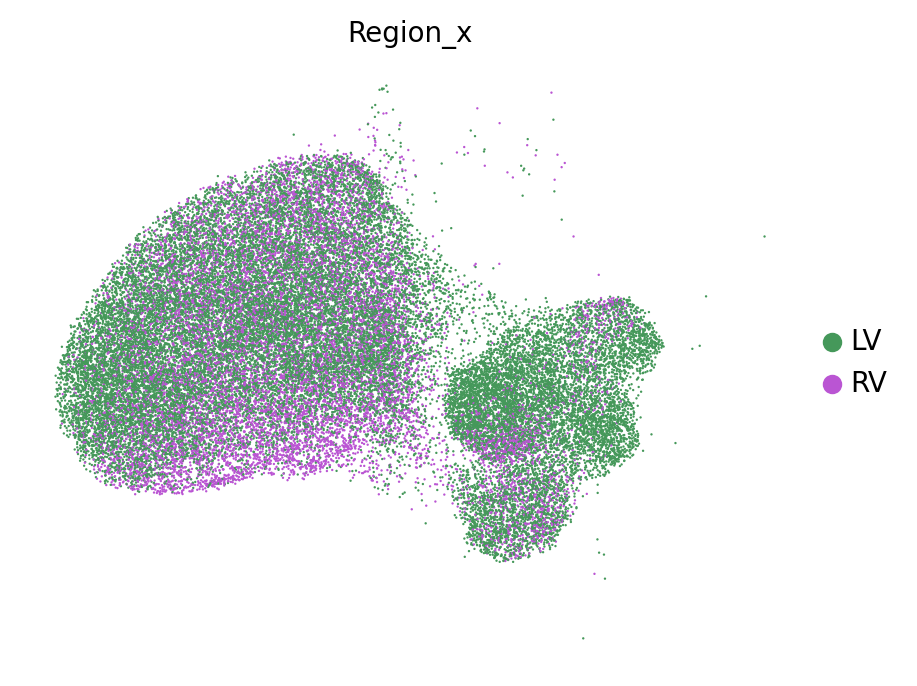

In [58]:
adata_fibro = sc.read(write_dir+'adata_fibro_processed.h5ad')
sc.pl.umap(adata_fibro,color = ['Region_x'],legend_fontsize=10,palette = ['#45985a','mediumorchid']
           ,save='heart_fibro_region.pdf')
adata_fibro_disease = adata_fibro[adata_fibro.obs.disease_renamed!='control']

H35 ['TTN']
Categories (1, object): ['TTN']
False    28939
True      2075
Name: H35, dtype: int64
LV #45985a (1457, 3)
RV #ba55d3 (618, 3)


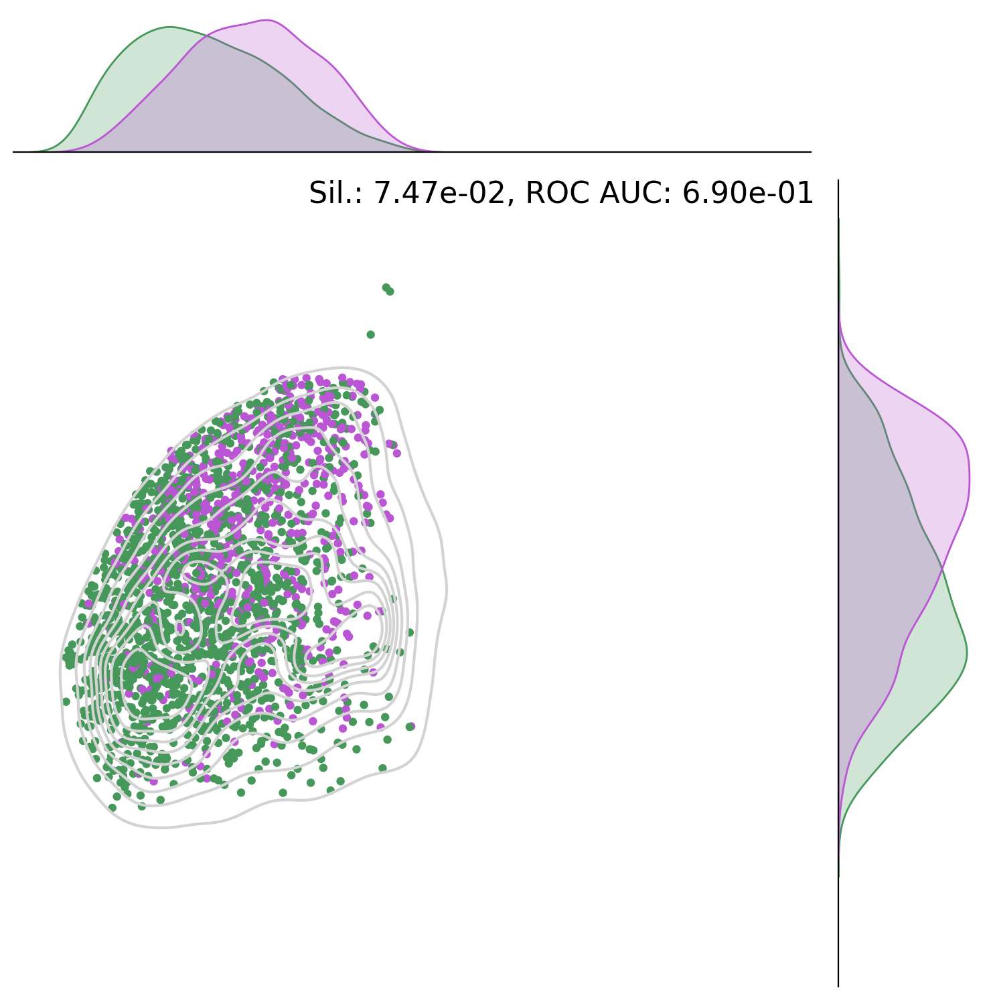

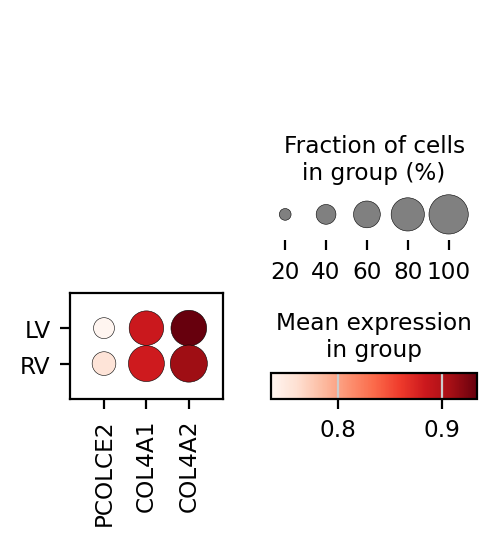

H29 ['PKP2']
Categories (1, object): ['PKP2']
False    29084
True      1930
Name: H29, dtype: int64
LV #45985a (1057, 3)
RV #ba55d3 (873, 3)


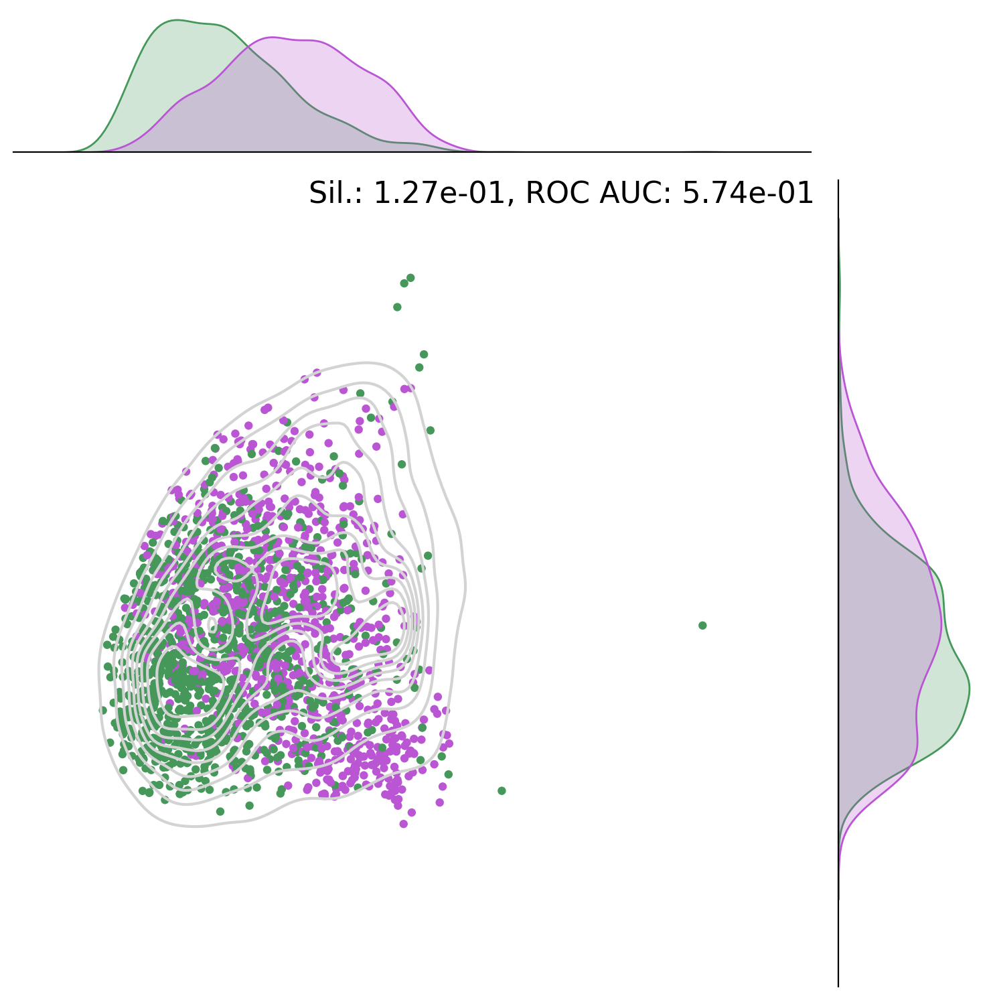

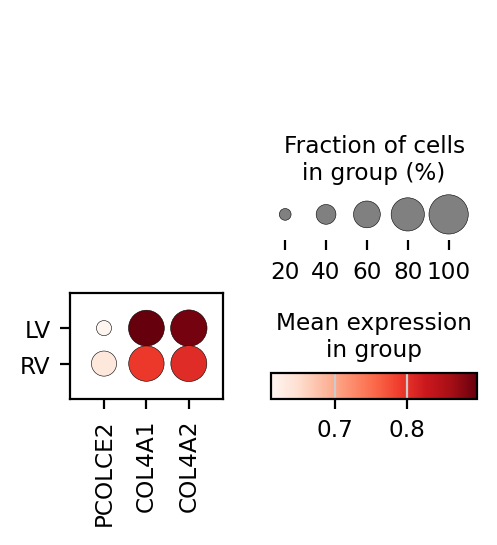

H20 ['RBM20']
Categories (1, object): ['RBM20']
False    29173
True      1841
Name: H20, dtype: int64
LV #45985a (600, 3)
RV #ba55d3 (1241, 3)


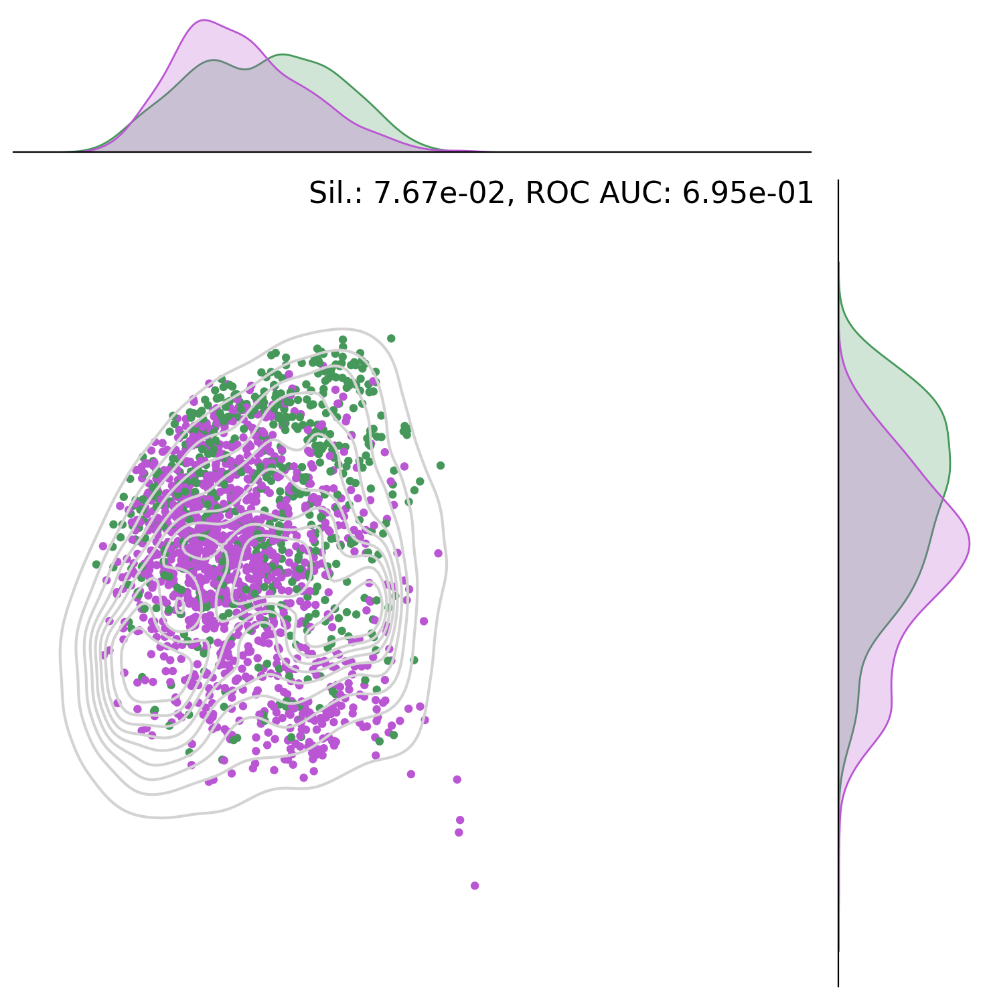

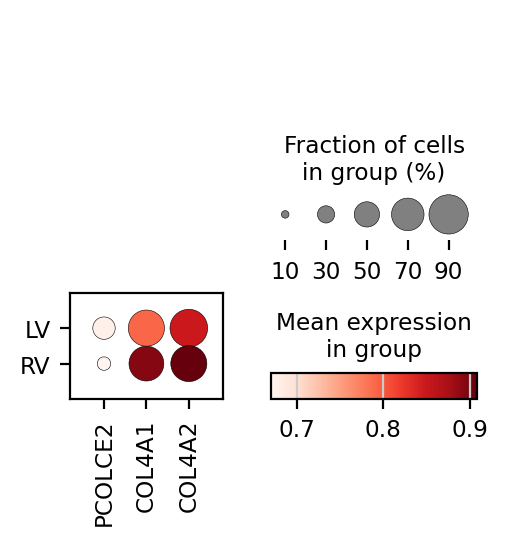

H19 ['RBM20']
Categories (1, object): ['RBM20']
False    27952
True      3062
Name: H19, dtype: int64
LV #45985a (2299, 3)
RV #ba55d3 (763, 3)


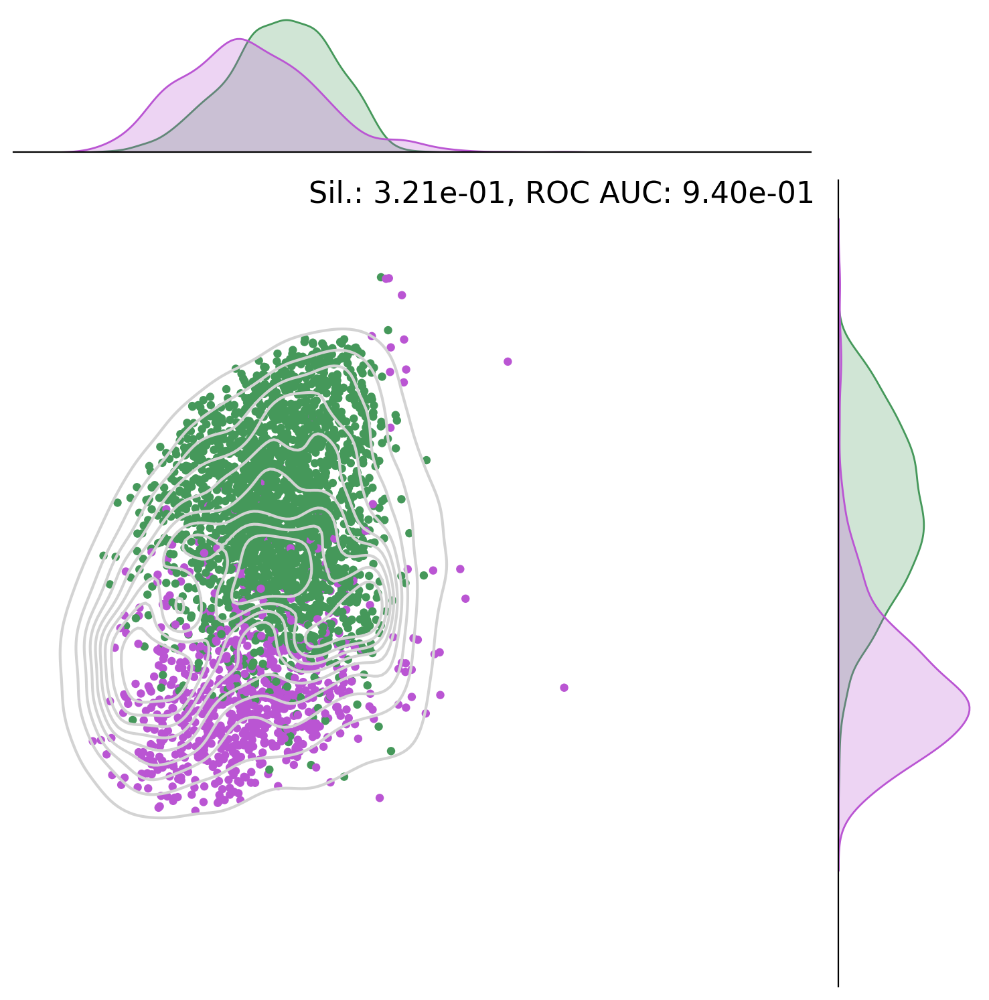

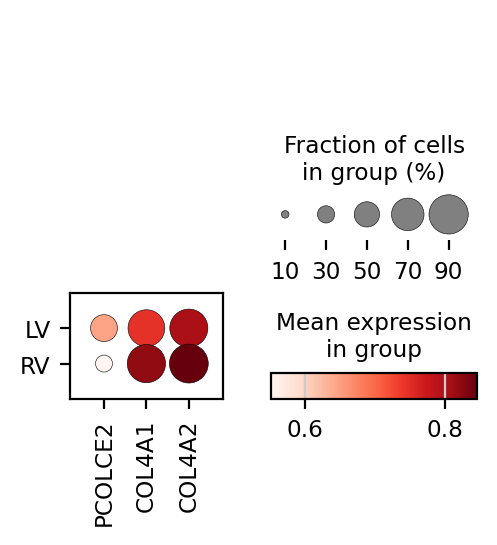

H11 ['PKP2']
Categories (1, object): ['PKP2']
False    26538
True      4476
Name: H11, dtype: int64
LV #45985a (3168, 3)
RV #ba55d3 (1308, 3)


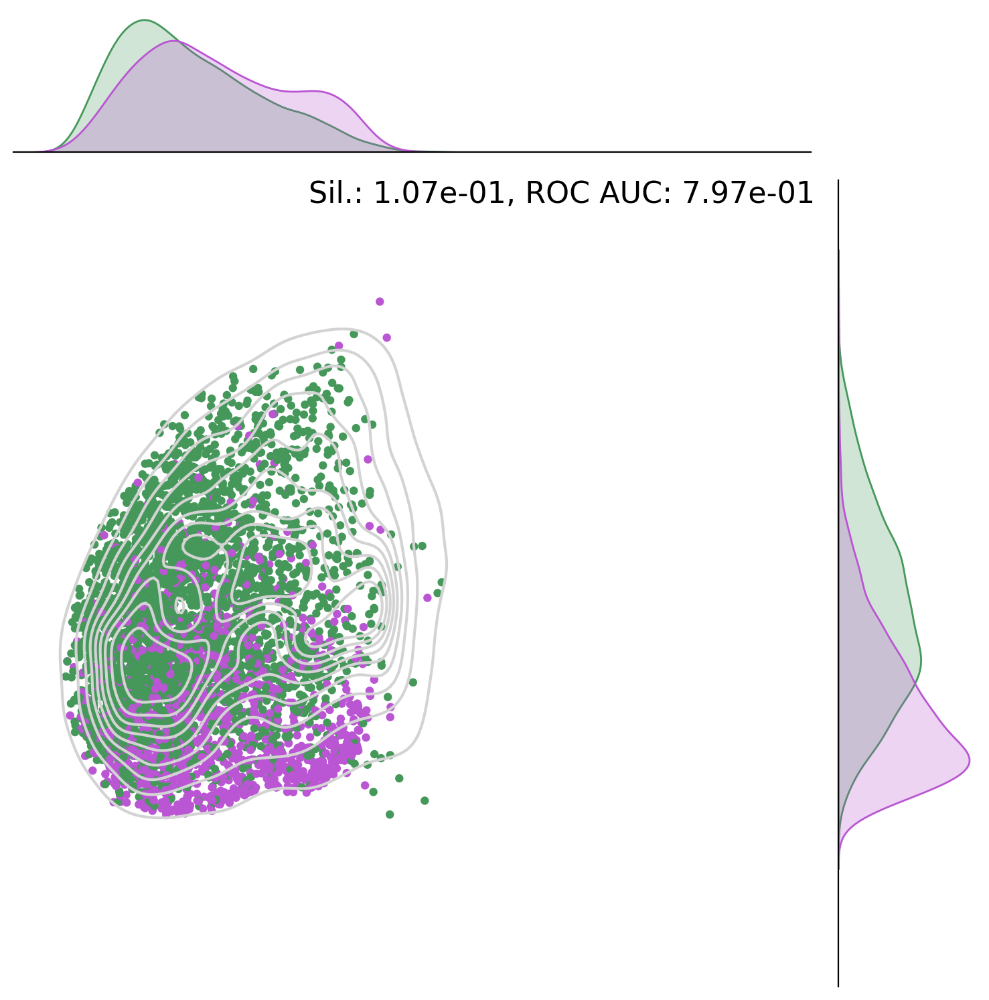

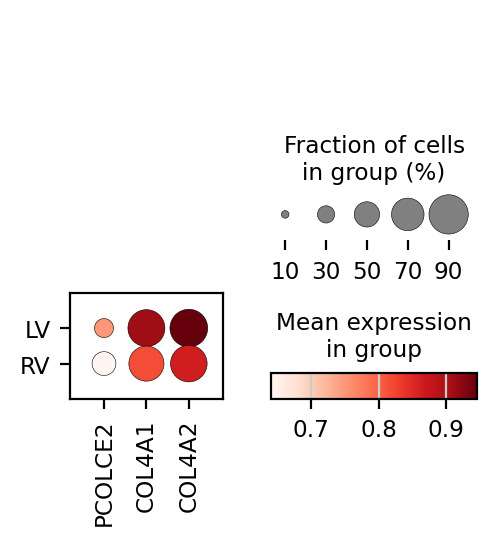

H22 ['RBM20']
Categories (1, object): ['RBM20']
False    29059
True      1955
Name: H22, dtype: int64
LV #45985a (1296, 3)
RV #ba55d3 (659, 3)


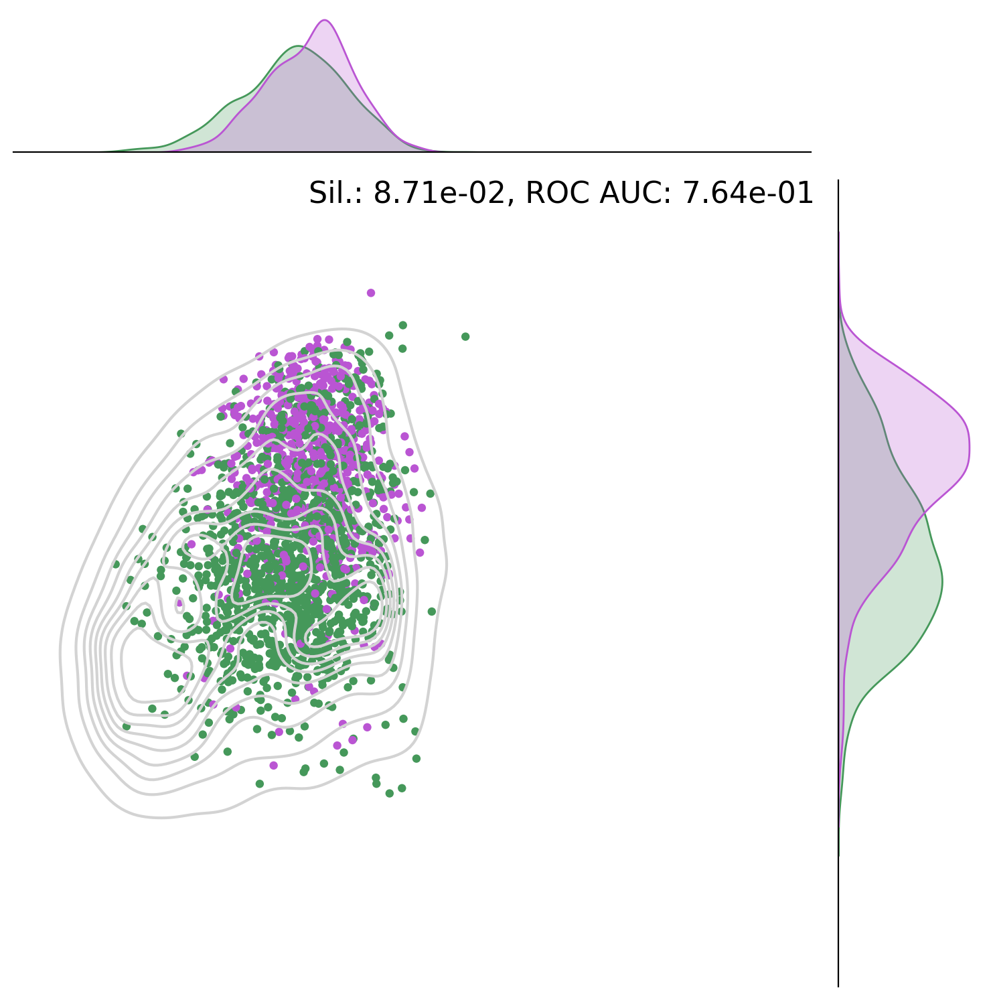

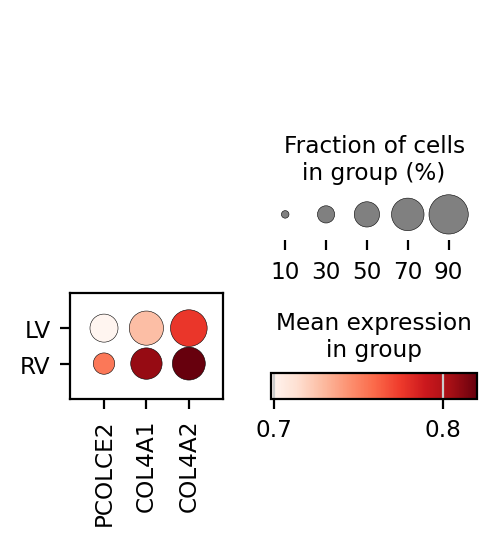

H08 ['PKP2']
Categories (1, object): ['PKP2']
False    27320
True      3694
Name: H08, dtype: int64
LV #45985a (2830, 3)
RV #ba55d3 (864, 3)


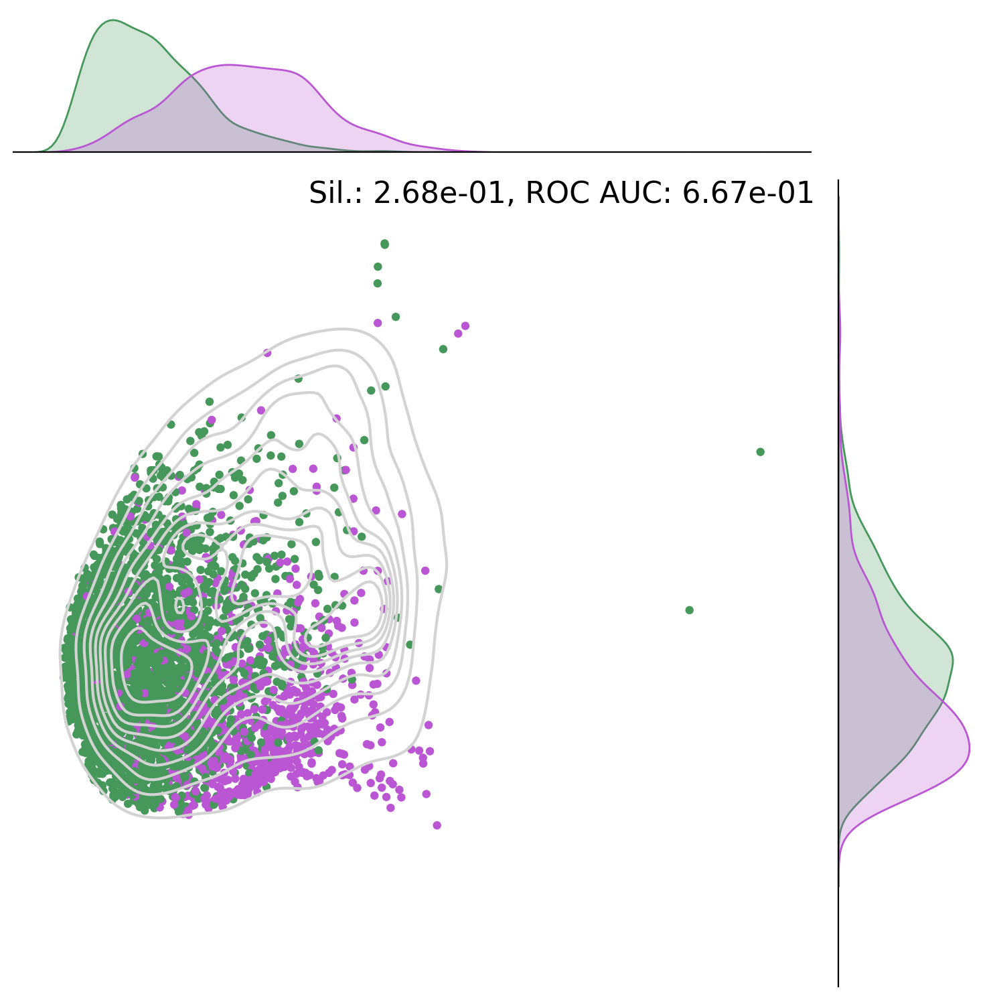

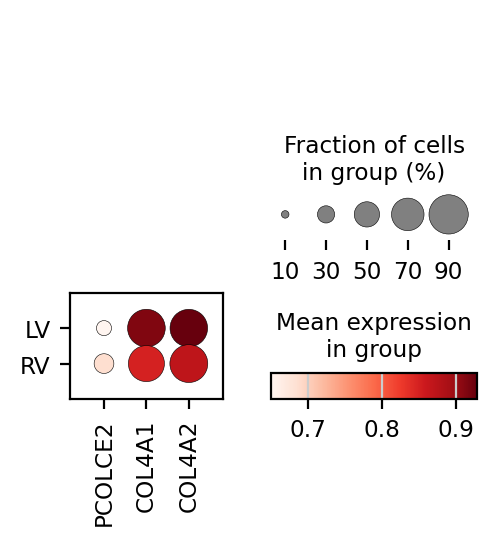

H31 ['LMNA']
Categories (1, object): ['LMNA']
False    30177
True       837
Name: H31, dtype: int64
LV #45985a (642, 3)
RV #ba55d3 (195, 3)


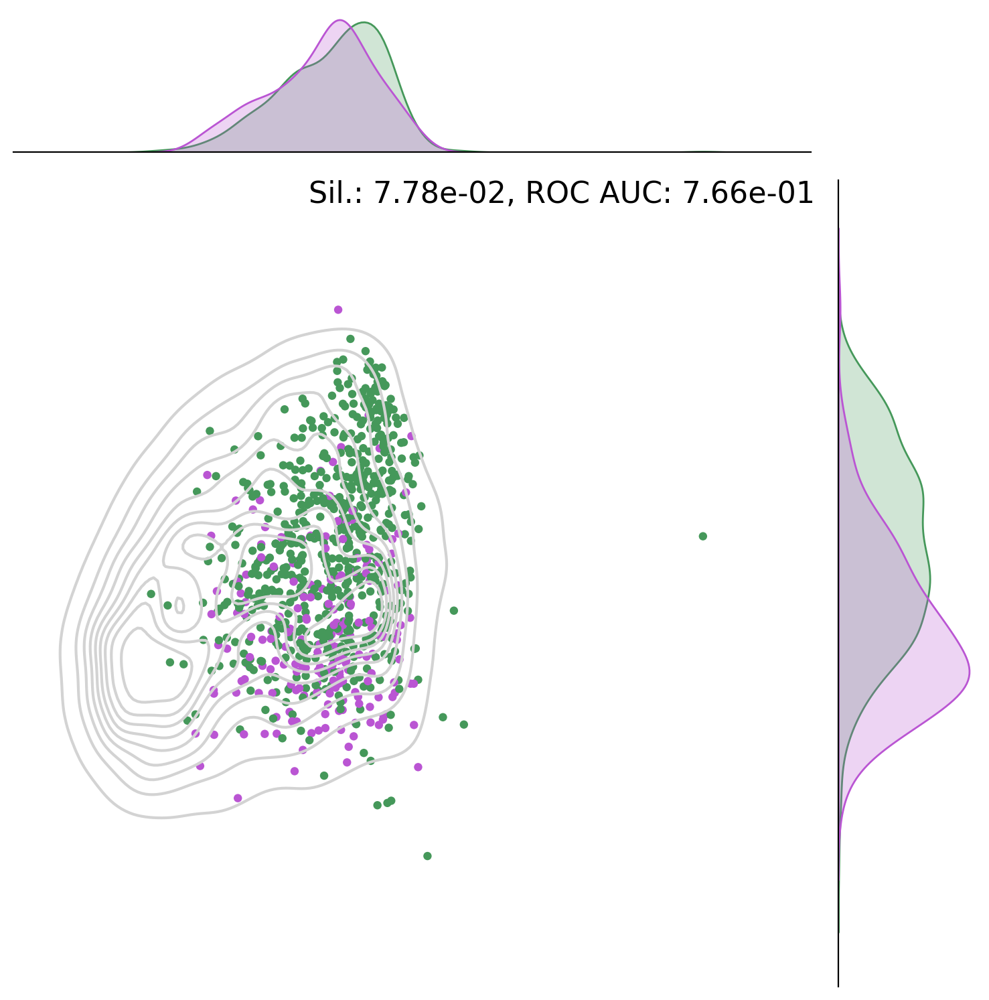

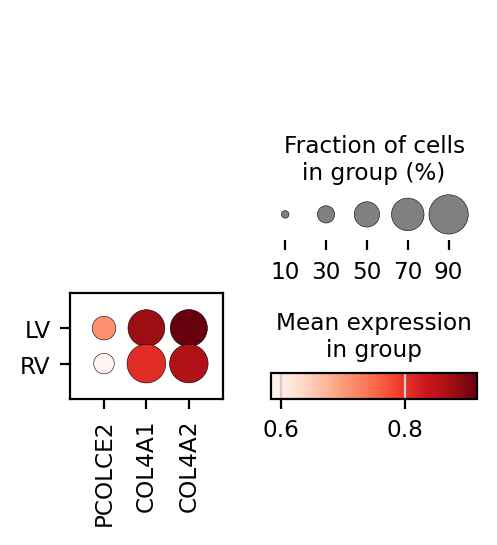

H36 ['TTN']
Categories (1, object): ['TTN']
False    29371
True      1643
Name: H36, dtype: int64
LV #45985a (628, 3)
RV #ba55d3 (1015, 3)


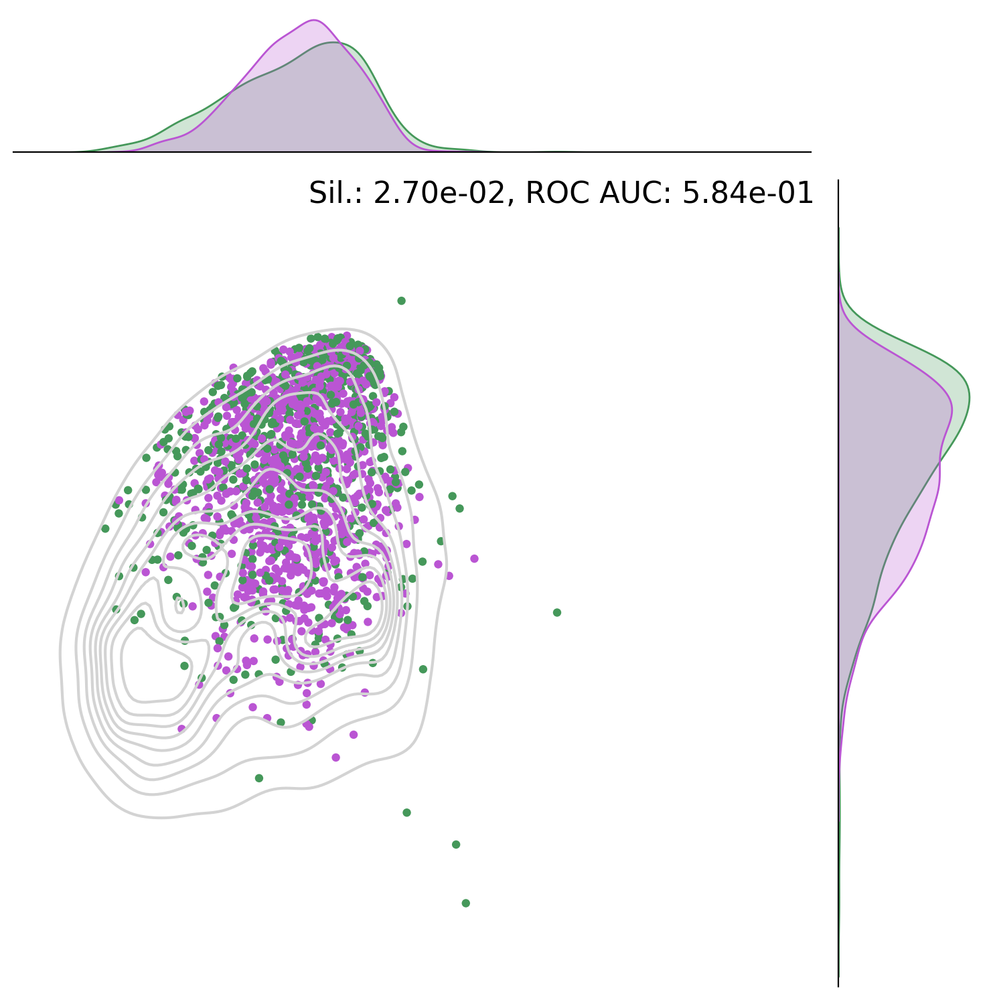

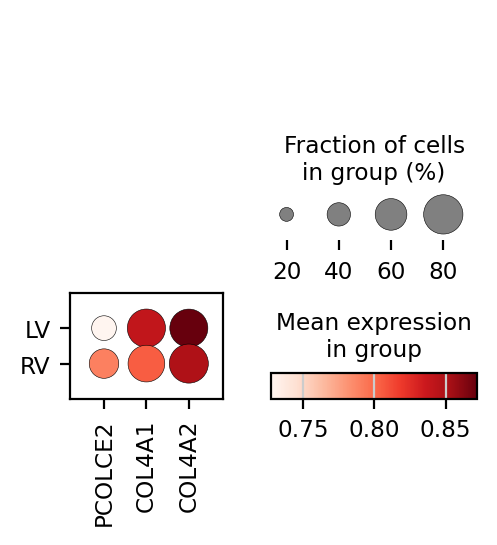

H14 ['TTN']
Categories (1, object): ['TTN']
False    28312
True      2702
Name: H14, dtype: int64
LV #45985a (1661, 3)
RV #ba55d3 (1041, 3)


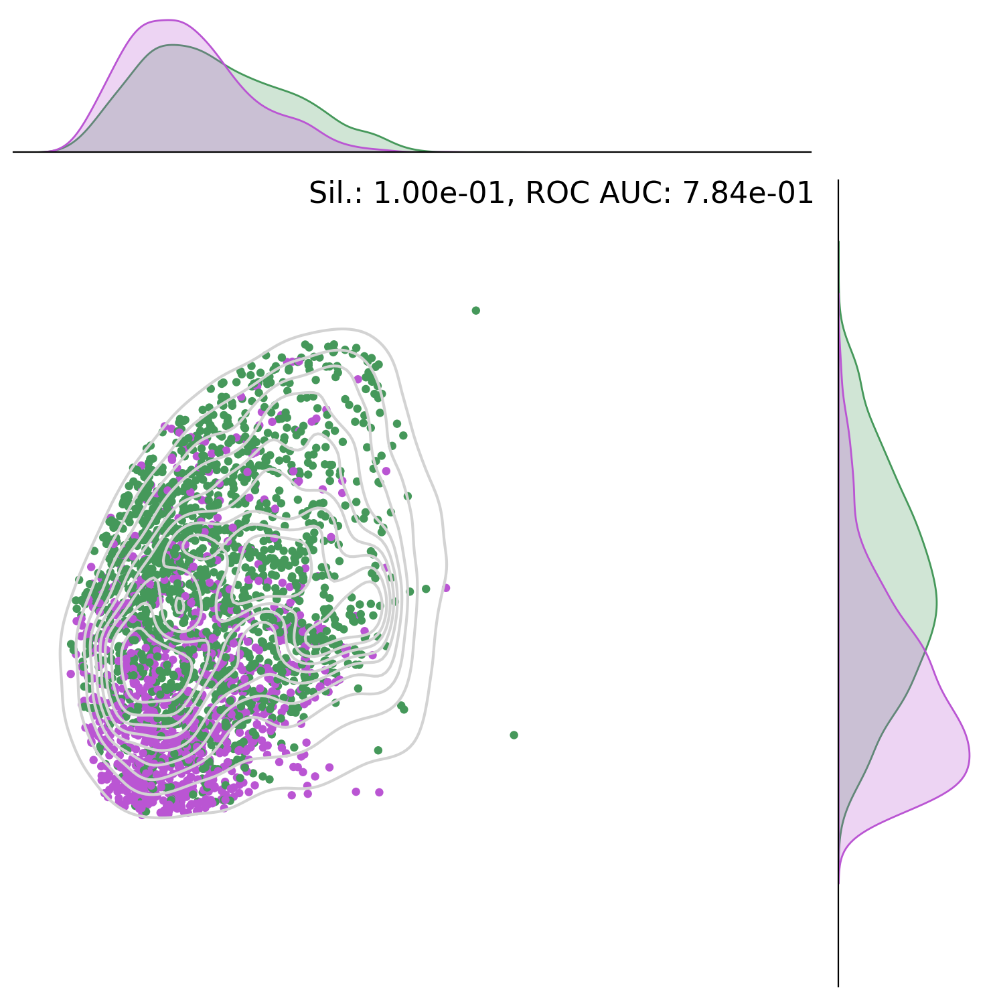

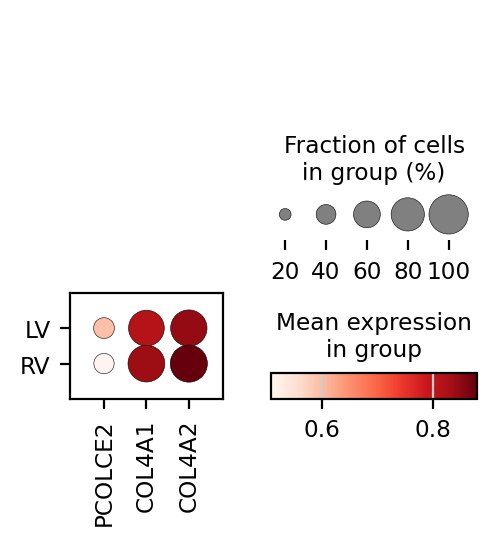

H34 ['TTN']
Categories (1, object): ['TTN']
False    30160
True       854
Name: H34, dtype: int64
LV #45985a (447, 3)
RV #ba55d3 (407, 3)


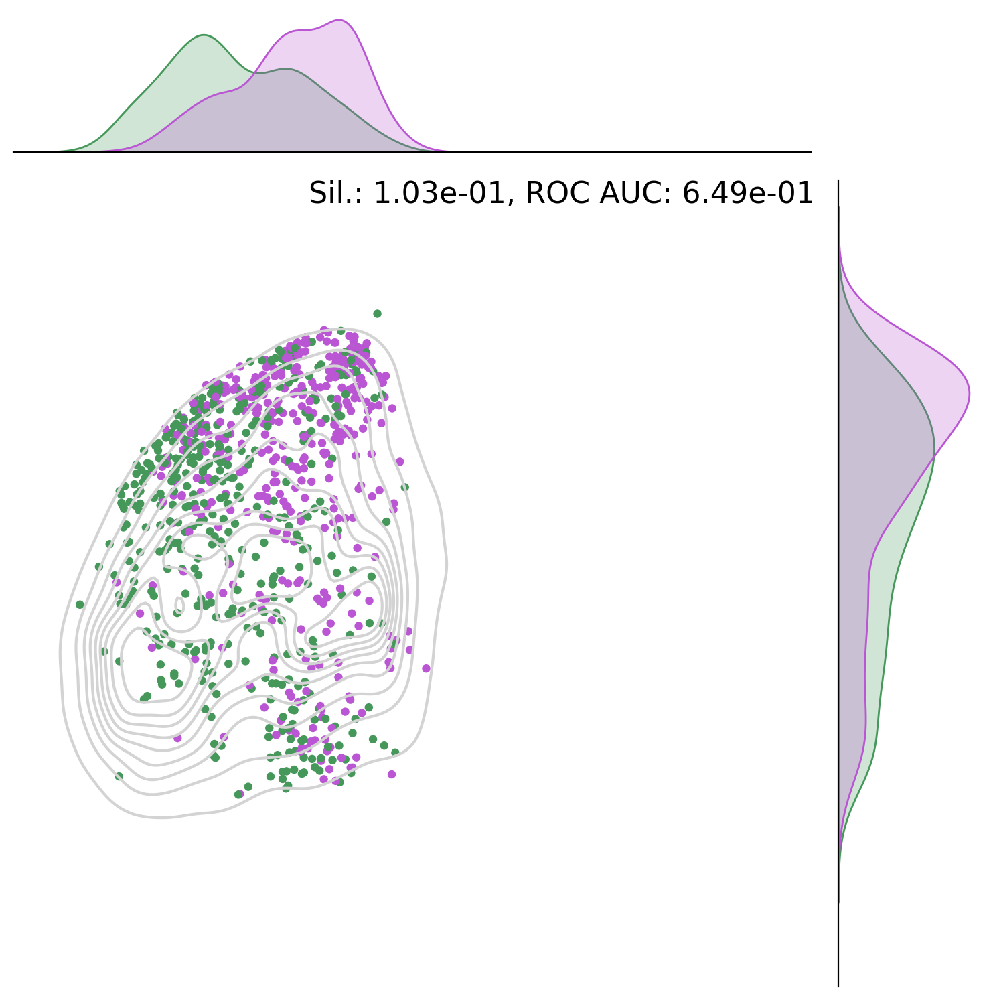

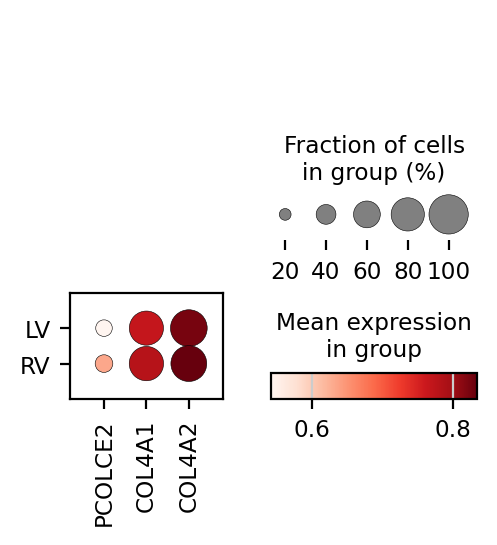

H06 ['LMNA']
Categories (1, object): ['LMNA']
False    28755
True      2259
Name: H06, dtype: int64
LV #45985a (1372, 3)
RV #ba55d3 (887, 3)


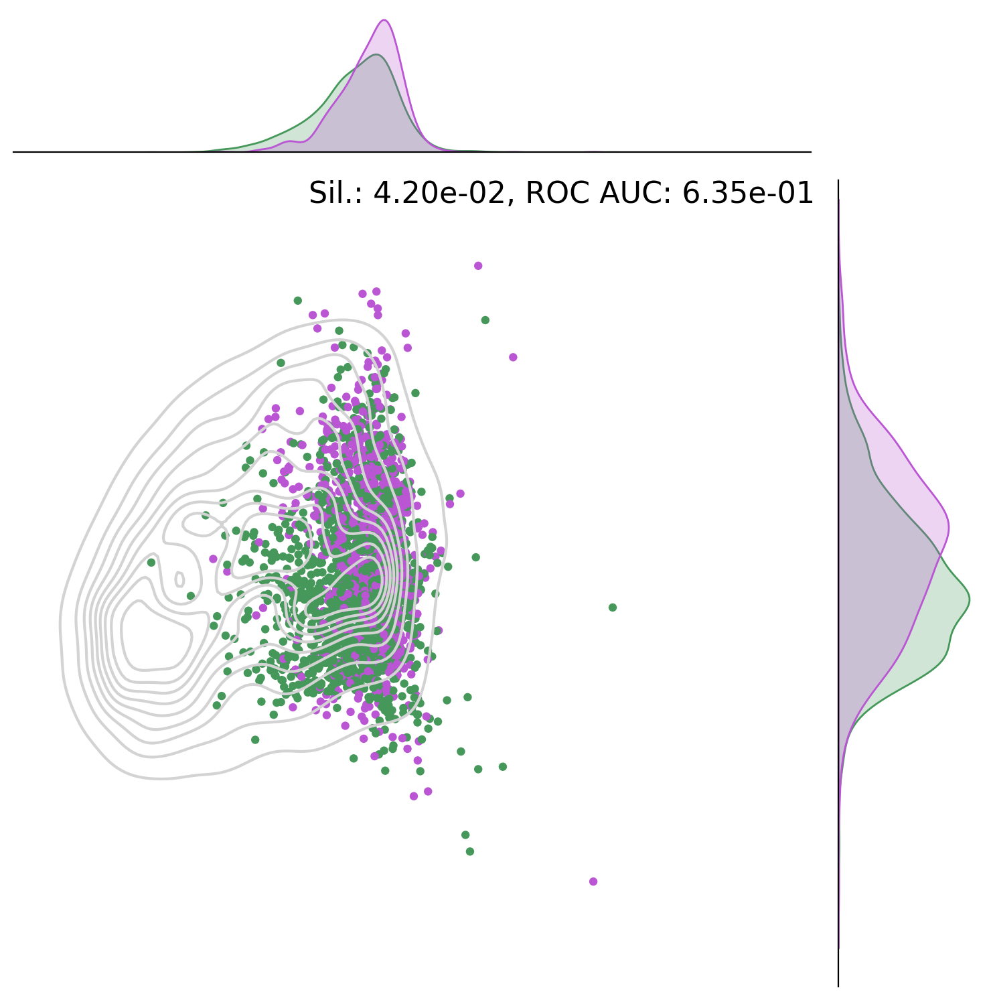

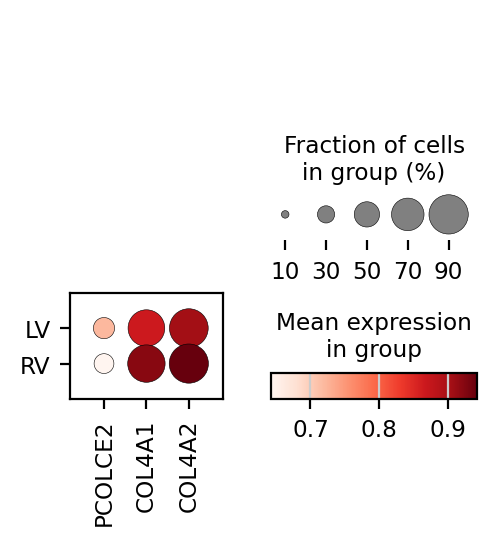

H33 ['RBM20']
Categories (1, object): ['RBM20']
False    28649
True      2365
Name: H33, dtype: int64
LV #45985a (1289, 3)
RV #ba55d3 (1076, 3)


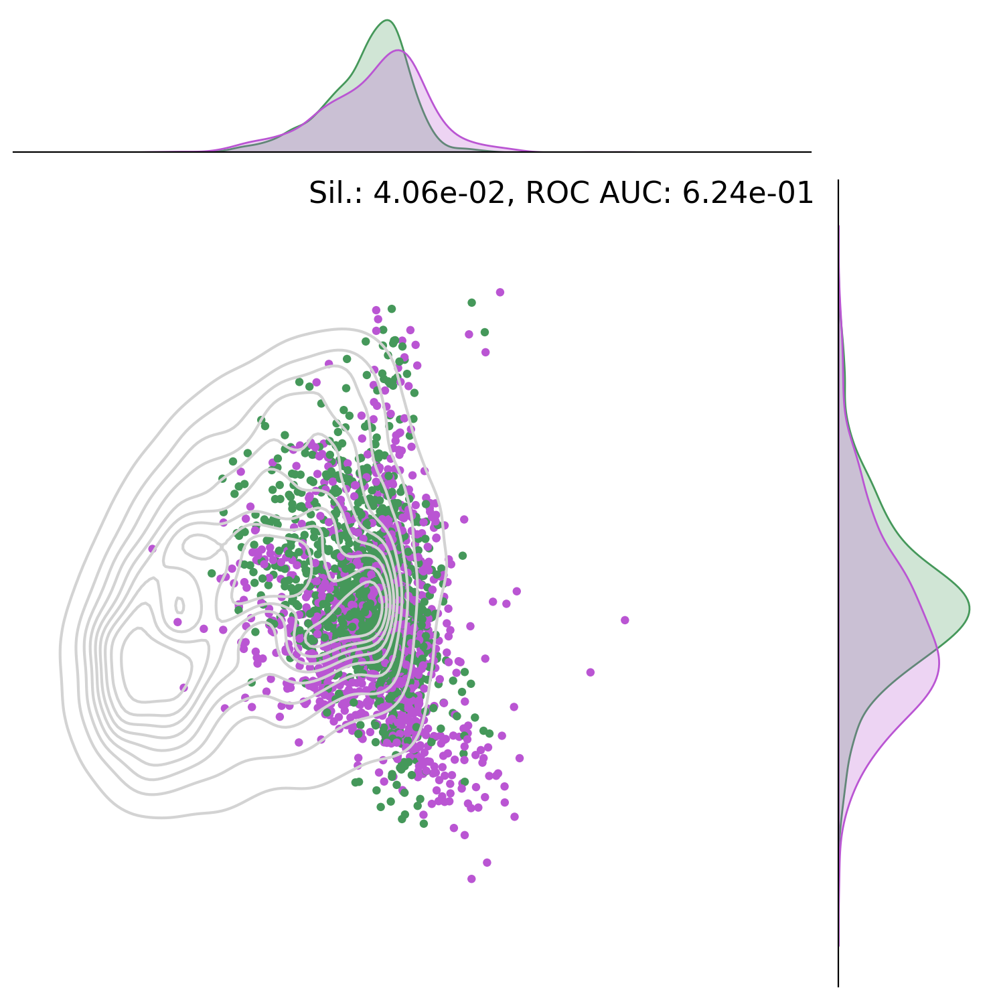

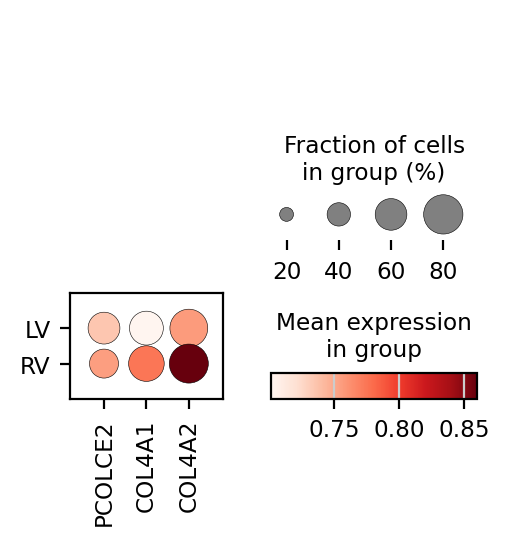

In [59]:
sc.set_figure_params(dpi=100,figsize=(5,4),fontsize=10,frameon=False)
adata_fibro_disease = adata_fibro[adata_fibro.obs.disease_renamed!='control']
for donor in adata_fibro_disease.obs.donor_id.unique():
    if (len(adata_fibro_disease[adata_fibro_disease.obs.donor_id==donor].obs.Region_x.unique())>1):
        # if (adata_fibro[adata_fibro.obs.donor_id==donor].obs['Primary.Genetic.Diagnosis'].unique()=='PKP2'):
        print(donor,adata_fibro_disease[adata_fibro_disease.obs.donor_id==donor].obs['Primary.Genetic.Diagnosis'].unique())
        adata_fibro_disease.obs[donor] = [True if adata_fibro_disease.obs.loc[x,'donor_id']==donor else False for x in adata_fibro_disease.obs_names]
        print(adata_fibro_disease.obs[donor].value_counts())
        plot_density(adata_fibro_disease,plot_basis="X_umap",color='Region_x',group=donor,s=20,palette = None,save_as='./figures/density_heart_fibro_'+donor+'.pdf')
        # sc.pl.umap(adata_fibro[adata_fibro.obs.donor_id==donor],color=['PCOLCE2','COL4A1','COL4A2','Region_x'])
        tmp = adata_fibro_disease[adata_fibro_disease.obs.donor_id==donor]
        sc.pl.dotplot(adata_fibro_disease[adata_fibro_disease.obs.donor_id==donor],var_names=['PCOLCE2','COL4A1','COL4A2'],groupby='Region_x',mean_only_expressed=True,use_raw=True,save='heart_fibro_genes_'+donor+'.pdf')
        # sc.pl.umap(tmp[tmp.obs.Region_x=='LV'],color=['PCOLCE2','COL4A1','COL4A2','Region_x'])
        # sc.pl.umap(tmp[tmp.obs.Region_x=='RV'],color=['PCOLCE2','COL4A1','COL4A2','Region_x'])

In [12]:
adata_fibro = sc.read(write_dir+'adata_fibro_processed.h5ad')

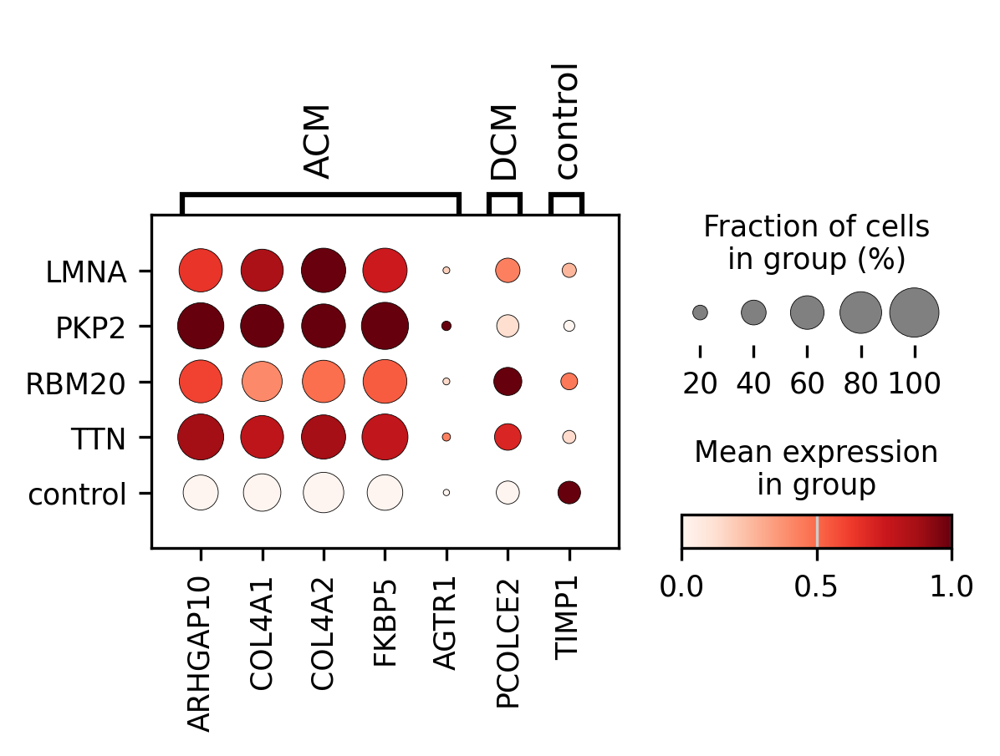

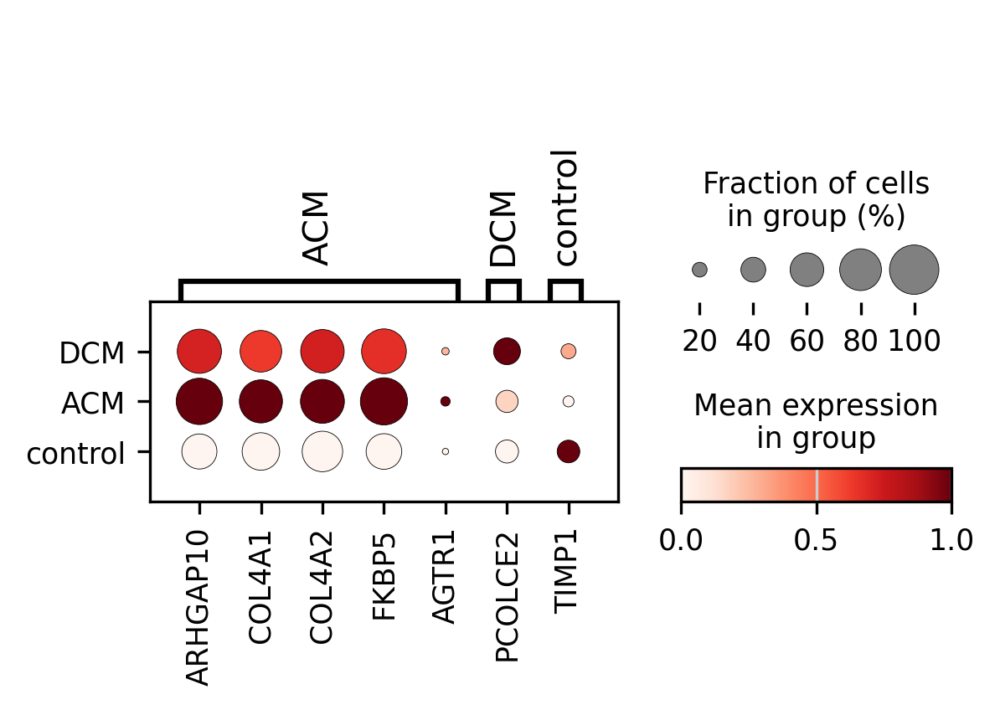

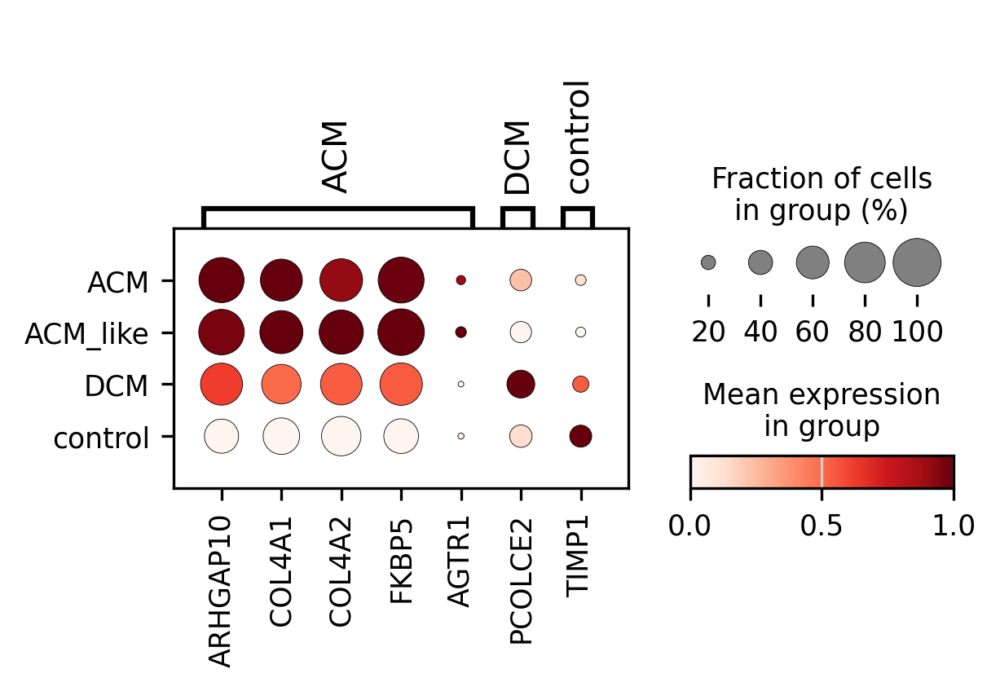

In [13]:
top_genes = {'ACM':['ARHGAP10','COL4A1', 'COL4A2','FKBP5', 'AGTR1'],'DCM':['PCOLCE2'], 'control':['TIMP1']} #XIRP1/2, ANKRD1, or ACTA1

sc.pl.dotplot(adata_fibro,var_names=top_genes,groupby='Primary.Genetic.Diagnosis',mean_only_expressed=False, standard_scale='var',use_raw=True,save='heart_fibro_genes_variants.pdf')
# sc.pl.dotplot(adata_fibro_LV,var_names=['FKBP5', 'AGTR1','PCOLCE2','TIMP1','ARHGAP10','COL4A1', 'COL4A2'],groupby='Primary.Genetic.Diagnosis',mean_only_expressed=False, standard_scale='var',use_raw=True)
# sc.pl.dotplot(adata_fibro_RV,var_names=['FKBP5', 'AGTR1','PCOLCE2','TIMP1','ARHGAP10','COL4A1', 'COL4A2'],groupby='Primary.Genetic.Diagnosis',mean_only_expressed=False, standard_scale='var',use_raw=True)


sc.pl.dotplot(adata_fibro,var_names=top_genes,groupby='disease_renamed',mean_only_expressed=False, standard_scale='var',use_raw=True,save='heart_fibro_genes_disease.pdf')
sc.pl.dotplot(adata_fibro,var_names=top_genes,groupby='disease_new',mean_only_expressed=False, standard_scale='var',use_raw=True,save='heart_fibro_genes_disease_new.pdf')

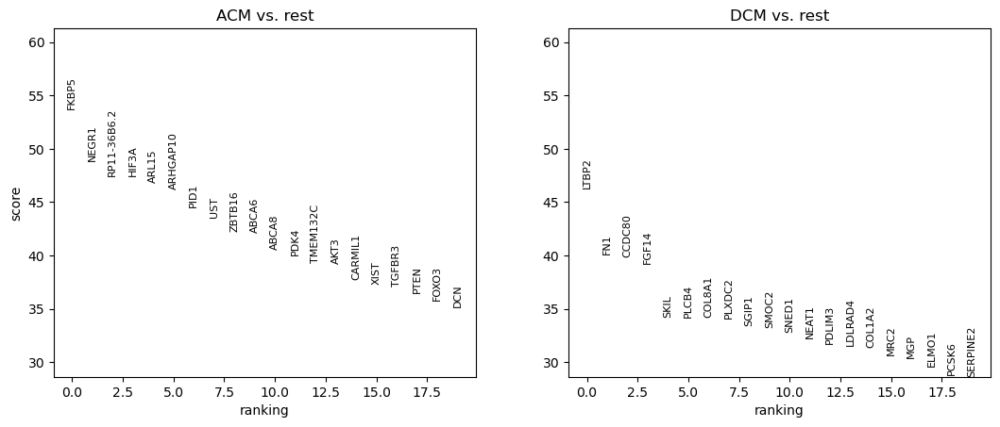

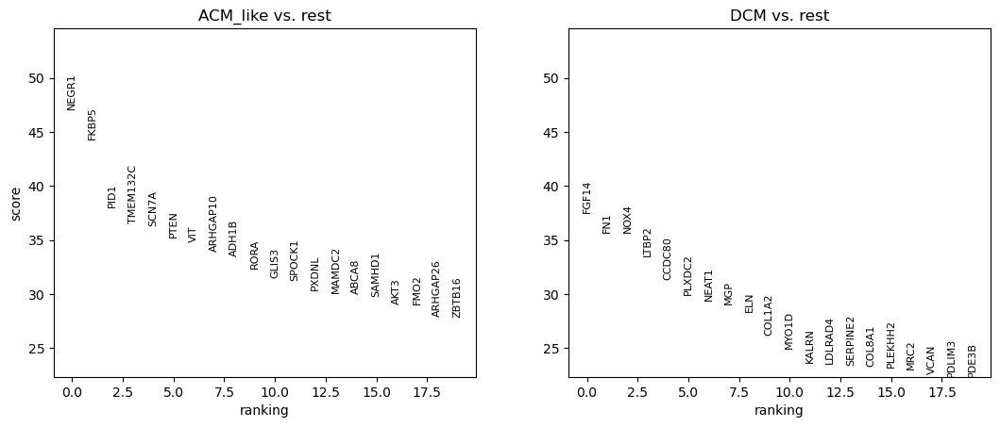

In [13]:
adata_fibro_DCM_ACM = adata_fibro[adata_fibro.obs.disease_new.isin(['DCM','ACM'])]
adata_fibro_DCM_ACM_like = adata_fibro[adata_fibro.obs.disease_new.isin(['DCM','ACM_like'])]

sc.tl.rank_genes_groups(adata_fibro_DCM_ACM,groupby ='disease_new',method='wilcoxon',use_raw=True)
sc.pl.rank_genes_groups(adata_fibro_DCM_ACM)

sc.tl.rank_genes_groups(adata_fibro_DCM_ACM_like,groupby ='disease_new',method='wilcoxon',use_raw=True)
sc.pl.rank_genes_groups(adata_fibro_DCM_ACM_like)

In [39]:
ACM_pd = sc.get.rank_genes_groups_df(adata_fibro_DCM_ACM, 'ACM').set_index("names").sort_values("scores", key=np.abs, ascending=False)[["scores","logfoldchanges",'pvals_adj']].rename_axis(['ACM'], axis=1)
ACM_pd = ACM_pd[ACM_pd['pvals_adj']<0.05]
ACM_pd_negativeFC = ACM_pd[ACM_pd['logfoldchanges']<0]
ACM_pd = ACM_pd[ACM_pd['logfoldchanges']>0]

ACM_like_pd = sc.get.rank_genes_groups_df(adata_fibro_DCM_ACM_like, 'ACM_like').set_index("names").sort_values("scores", key=np.abs, ascending=False)[["scores","logfoldchanges",'pvals_adj']].rename_axis(['ACM_like'], axis=1)
ACM_like_pd = ACM_like_pd[ACM_like_pd['pvals_adj']<0.05]
ACM_like_pd_negativeFC = ACM_like_pd[ACM_like_pd['logfoldchanges']<0]
ACM_like_pd = ACM_like_pd[ACM_like_pd['logfoldchanges']>0]

In [40]:
DE_intersect = np.intersect1d(ACM_pd.index,ACM_like_pd.index)

In [41]:
len(DE_intersect)

591

In [42]:
ACM_pd.shape

(734, 3)

In [43]:
ACM_like_pd.shape

(1164, 3)

In [ ]:
import gseapy
import matplotlib.pyplot as plt

In [68]:
enr = gseapy.enrichr(gene_list=list(ACM_like_pd.index), # or "./tests/data/gene_list.txt",
                 gene_sets='GO_Biological_Process_2023',
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

In [21]:
enr.res2d[:50]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2023,"Regulation Of mRNA Splicing, Via Spliceosome (...",18/94,3.120465e-07,0.000574,0,0,4.893276,73.301837,DDX17;RBM39;RBM25;RBFOX1;WTAP;YTHDC1;CELF2;CIR...
1,GO_Biological_Process_2023,Branched-Chain Amino Acid Catabolic Process (G...,8/17,3.753804e-07,0.000574,0,0,18.231312,269.738201,MCCC2;ALDH6A1;HIBADH;BCKDHB;MCCC1;DBT;DLD;HMGCLL1
2,GO_Biological_Process_2023,Protein Ubiquitination (GO:0016567),45/434,5.450441e-07,0.000574,0,0,2.421784,34.927936,PRKN;ANAPC16;CUL5;UHRF2;TNKS;FBH1;CUL3;PELI2;U...
3,GO_Biological_Process_2023,Presynaptic Membrane Organization (GO:0097090),6/9,7.741635e-07,0.000612,0,0,40.945220,576.159957,NLGN4Y;PTPRD;NLGN4X;IL1RAPL1;PTEN;LRP4
4,GO_Biological_Process_2023,Protein Polyubiquitination (GO:0000209),28/226,2.677508e-06,0.001692,0,0,2.934849,37.655944,PRKN;TNKS;CUL3;PELI2;UBE2D3;NT5C2;NPEPPS;RNF11...
5,GO_Biological_Process_2023,Peroxisome Proliferator Activated Receptor Sig...,5/7,4.334292e-06,0.001957,0,0,51.129292,631.393189,NCOA1;NCOA2;FAM120B;PDK3;PPARG
6,GO_Biological_Process_2023,Positive Regulation Of Adipose Tissue Developm...,5/7,4.334292e-06,0.001957,0,0,51.129292,631.393189,NCOA1;NCOA2;PRKAA1;PPARG;SIRT1
7,GO_Biological_Process_2023,Presynaptic Membrane Assembly (GO:0097105),5/8,1.111028e-05,0.004389,0,0,34.084406,388.822638,NLGN4Y;PTPRD;NLGN4X;PTEN;LRP4
8,GO_Biological_Process_2023,Protein Phosphorylation (GO:0006468),45/500,2.261242e-05,0.007283,0,0,2.063174,22.069801,ATF2;PRKAA1;TNKS;PRKAG2;EGFR;IGF1R;STK3;MAPK8;...
9,GO_Biological_Process_2023,Regulation Of Basement Membrane Organization (...,4/5,2.304671e-05,0.007283,0,0,81.723473,872.642224,LAMA2;LAMB1;LAMC1;NID1


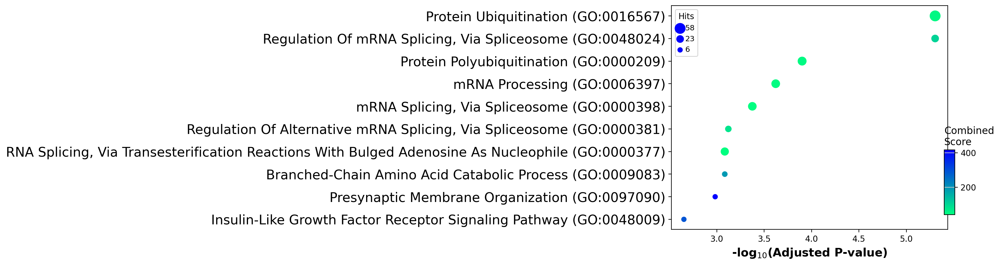

In [69]:
gseapy.plot.dotplot(enr.res2d,size=20,figsize=(6,5),x='Odds Ratio',cmap = plt.cm.winter_r)
gseapy.plot.dotplot(enr.res2d,size=20,figsize=(6,5),x='Odds Ratio',cmap = plt.cm.winter_r,ofname='./figures/heart_fibro_GO_pathway_ACM_like_pd.pdf')

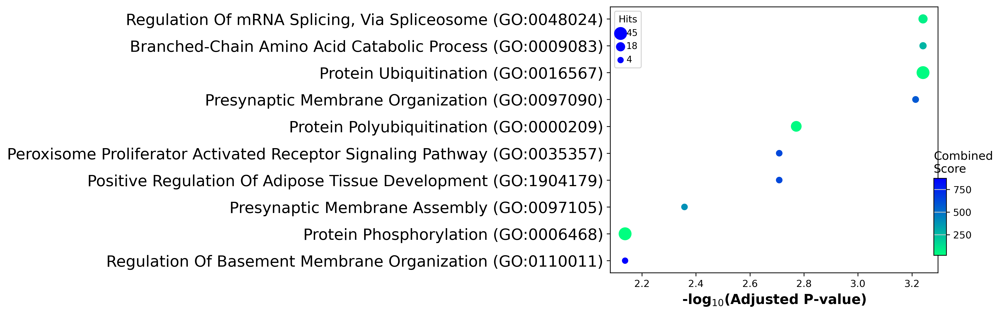

In [29]:
# gseapy.plot.dotplot(enr.res2d,size=20,figsize=(6,5),x='Odds Ratio',cmap = plt.cm.winter_r)
# gseapy.plot.dotplot(enr.res2d,size=20,figsize=(6,5),x='Odds Ratio',cmap = plt.cm.winter_r,ofname='./figures/heart_fibro_GO_pathway_ACM_like_pd.pdf')

In [19]:
gseapy.get_library_name(organism='human')

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'Azimuth_2023',
 'Azimuth_Cell_Types_2021',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_2024',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'ChEA_2022',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'DGIdb_Drug_Targets_2024',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMap_CRISPR_GeneDependency_CellLines_2023',
 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019',
 'DepMap_WG_CRISPR_Screens_Sanger_Cell

In [70]:
enr2 = gseapy.enrichr(gene_list=list(ACM_like_pd_negativeFC.index), # or "./tests/data/gene_list.txt",
                 gene_sets='GO_Biological_Process_2023',#'Reactome_2022', #GO_Biological_Process_2023
                 organism='human', # don't forget to set organism to the one you desired! e.g. Yeast
                 outdir=None, # don't write to disk
                )

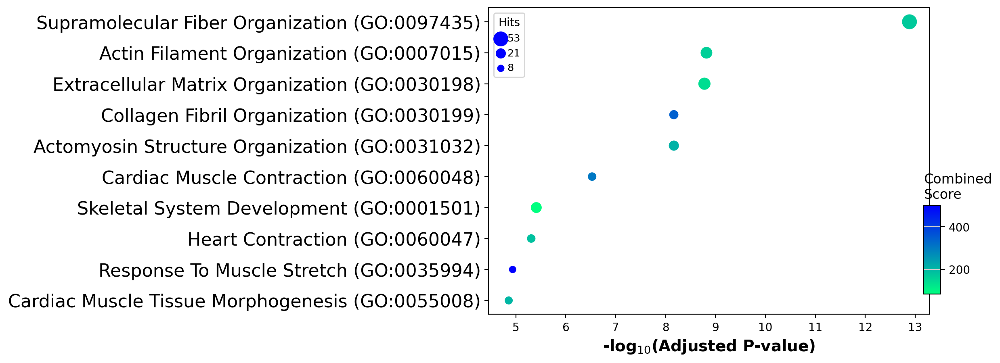

In [71]:
gseapy.plot.dotplot(enr2.res2d,size=20,figsize=(7,5),x='Odds Ratio',cmap = plt.cm.winter_r)
gseapy.plot.dotplot(enr2.res2d,size=20,figsize=(7,5),x='Odds Ratio',cmap = plt.cm.winter_r,ofname='./figures/heart_fibro_GO_pathway_ACM_like_pd_negativeFC.pdf')

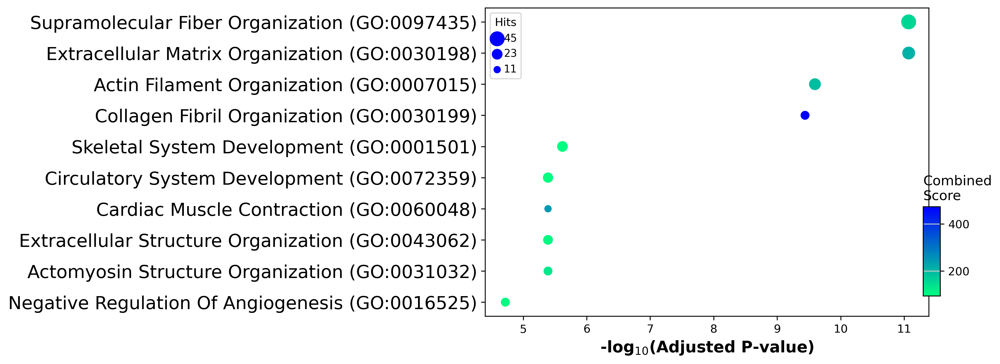

In [28]:
# gseapy.plot.dotplot(enr2.res2d,size=20,figsize=(7,5),x='Odds Ratio',cmap = plt.cm.winter_r)
# gseapy.plot.dotplot(enr2.res2d,size=20,figsize=(7,5),x='Odds Ratio',cmap = plt.cm.winter_r,ofname='./figures/heart_fibro_GO_pathway_ACM_like_pd_negativeFC.pdf')

### metacell

#### SEACells for LV

In [15]:
import SEACells

In [16]:
n_SEACells = 100
build_kernel_on = 'X_FinVAE_25_5' # key in ad.obsm to use for computing metacells
                          # This would be replaced by 'X_svd' for ATAC data

## Additional parameters
n_waypoint_eigs = 10 # Number of eigenvalues to consider when initializing metacells

In [17]:
sc.set_figure_params(dpi=150,figsize=(5,4),fontsize=10,frameon=False)
adata_fibro = sc.read(write_dir+'adata_fibro_processed.h5ad')

In [21]:
model = SEACells.core.SEACells(adata_fibro, 
                  build_kernel_on=build_kernel_on, 
                  n_SEACells=n_SEACells, 
                  n_waypoint_eigs=n_waypoint_eigs,
                  convergence_epsilon = 1e-5)

Welcome to SEACells!


In [23]:
model.construct_kernel_matrix()
M = model.kernel_matrix

Computing kNN graph using scanpy NN ...
Computing radius for adaptive bandwidth kernel...


  0%|          | 0/41675 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


  0%|          | 0/41675 [00:00<?, ?it/s]

Building similarity LIL matrix...


  0%|          | 0/41675 [00:00<?, ?it/s]

Constructing CSR matrix...


FileNotFoundError: [Errno 2] No such file or directory: '/tmp/tmp2jp6k_xq/gseapy.enrichr..log'

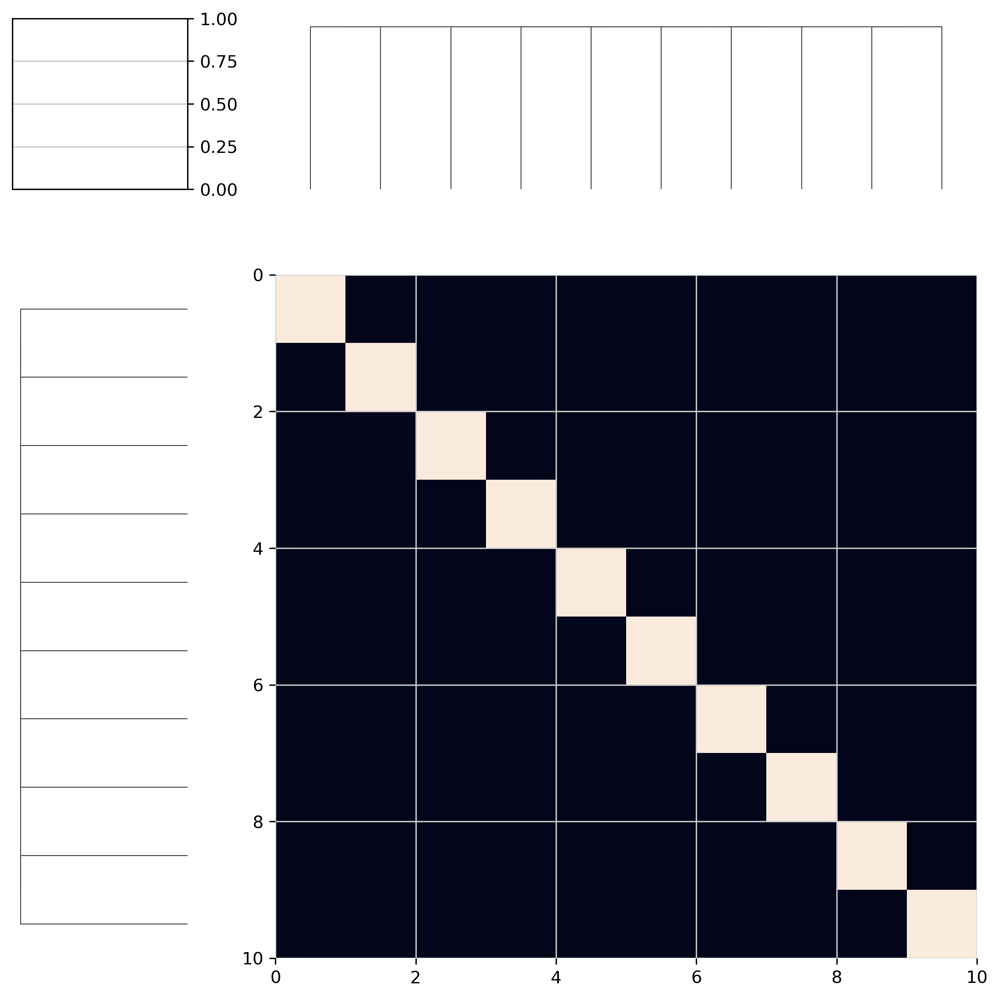

In [82]:
sns.clustermap(M.toarray()[:10,:10])

Building kernel on X_FinVAE_25_5
Computing diffusion components from X_FinVAE_25_5 for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 98 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 12/12 [00:00<00:00, 22.39it/s]


Selecting 2 cells from greedy initialization.


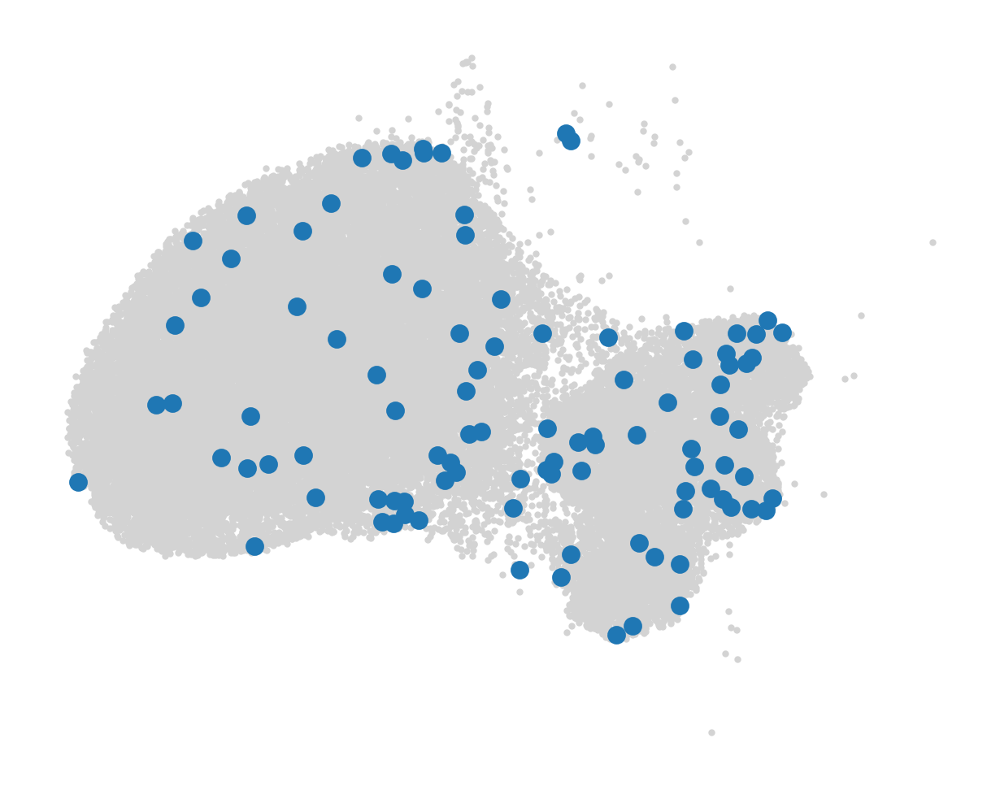

In [24]:
model.initialize_archetypes()

# Plot the initilization to ensure they are spread across phenotypic space
SEACells.plot.plot_initialization(adata_fibro, model)

In [25]:
model.fit(min_iter=10, max_iter=50)

Randomly initialized A matrix.
Setting convergence threshold at 0.00376
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Converged after 17 iterations.


In [26]:
# You can force the model to run additional iterations step-wise using the .step() function
print(f'Ran for {len(model.RSS_iters)} iterations')
for _ in range(5):
    model.step()
print(f'Ran for {len(model.RSS_iters)} iterations')

Ran for 18 iterations
Ran for 23 iterations


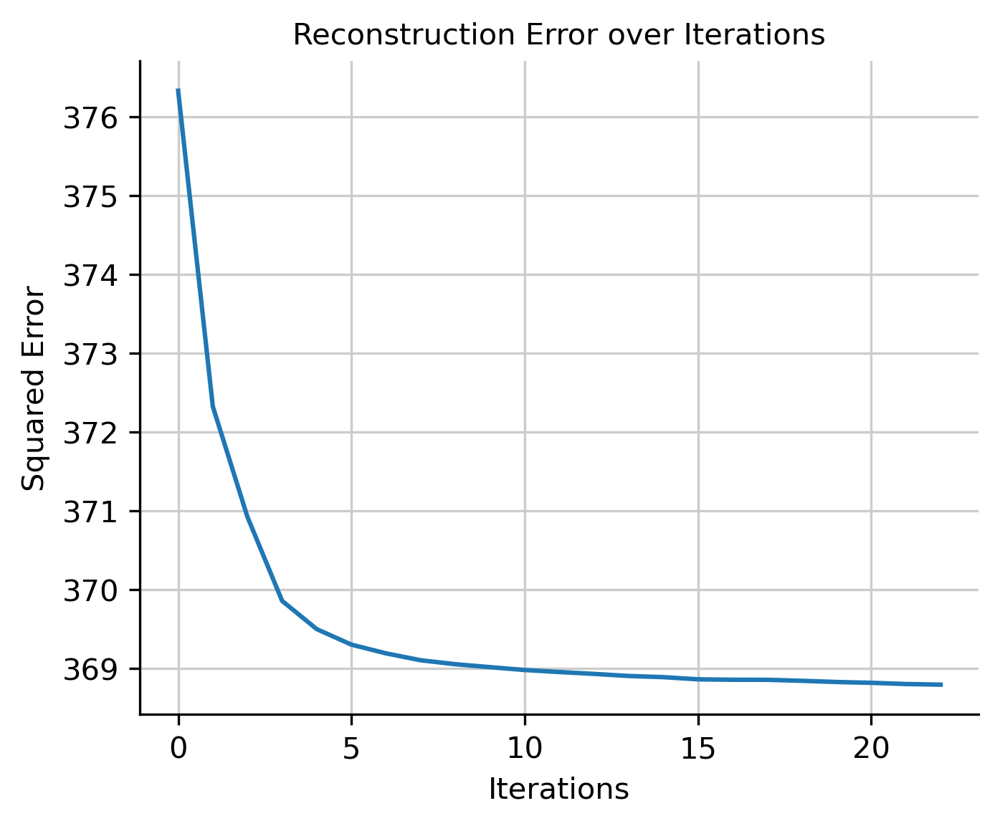

In [21]:
# Check for convergence 
model.plot_convergence()

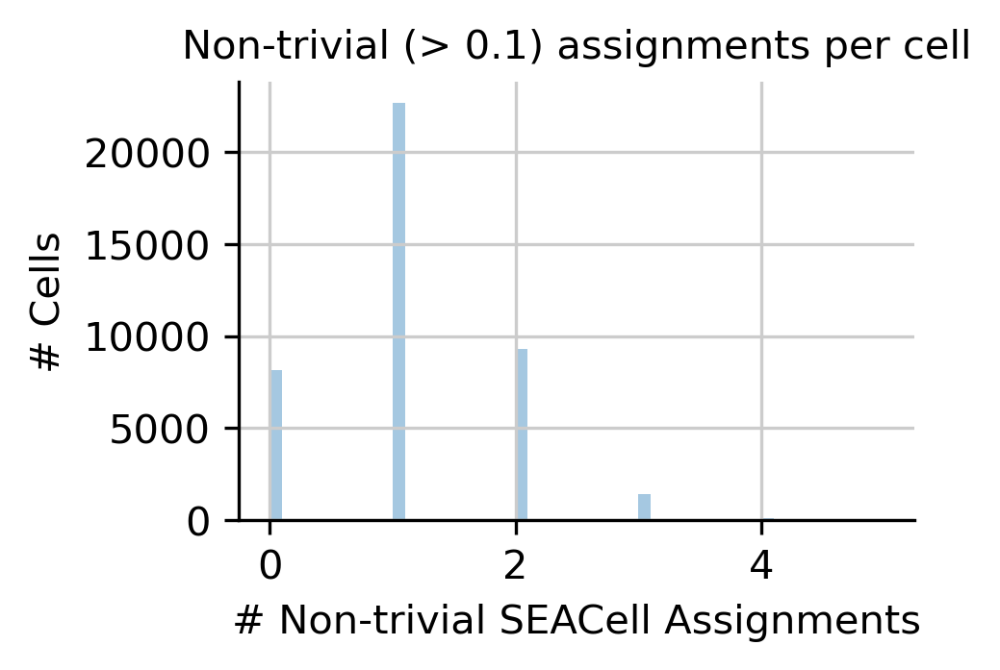

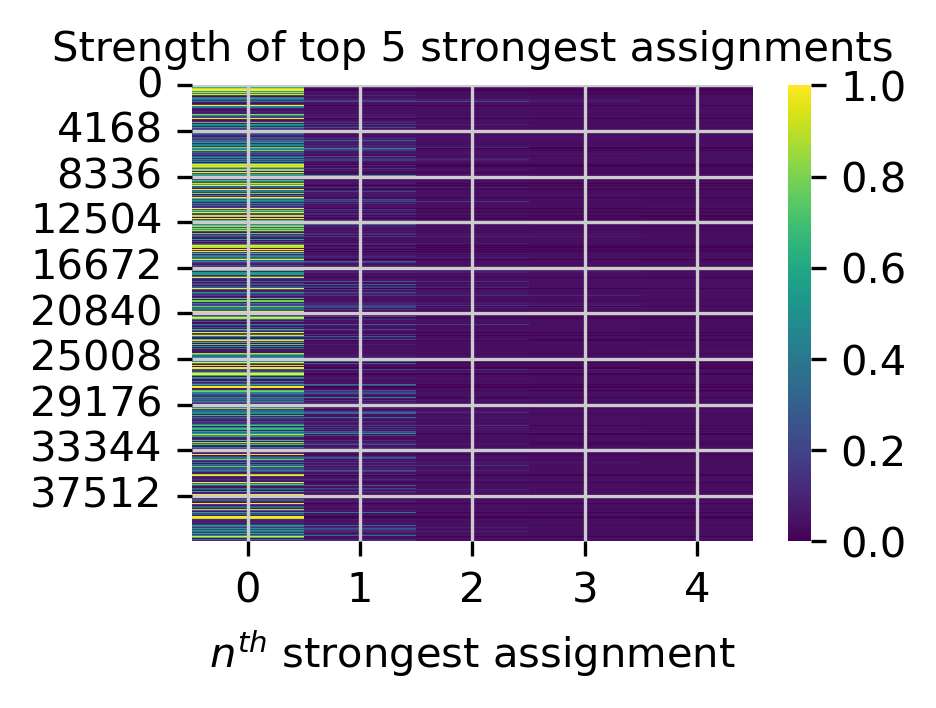

In [22]:
plt.figure(figsize=(3,2))
sns.distplot((model.A_.T > 0.1).sum(axis=1), kde=False)
plt.title(f'Non-trivial (> 0.1) assignments per cell')
plt.xlabel('# Non-trivial SEACell Assignments')
plt.ylabel('# Cells')
plt.show()

plt.figure(figsize=(3,2))
b = np.partition(model.A_.T, -5)    
sns.heatmap(np.sort(b[:,-5:])[:, ::-1], cmap='viridis', vmin=0)
plt.title('Strength of top 5 strongest assignments')
plt.xlabel('$n^{th}$ strongest assignment')
plt.show()

In [27]:
labels,weights = model.get_soft_assignments()

In [28]:
SEACell_ad = SEACells.core.summarize_by_SEACell(adata_fibro, SEACells_label='SEACell', summarize_layer='counts')
SEACell_ad

100%|██████████| 100/100 [00:03<00:00, 27.84it/s]


AnnData object with n_obs × n_vars = 100 × 5000
    layers: 'raw'

In [29]:
adata_fibro.layers['X'] = adata_fibro.X.copy()

In [30]:
SEACell_soft_ad = SEACells.core.summarize_by_soft_SEACell(adata_fibro, model.A_, celltype_label='Primary.Genetic.Diagnosis',summarize_layer='X', minimum_weight=0.05)
SEACell_soft_ad

100%|██████████| 100/100 [04:26<00:00,  2.66s/it]


AnnData object with n_obs × n_vars = 100 × 5000
    obs: 'Pseudo-sizes', 'celltype', 'celltype_purity'

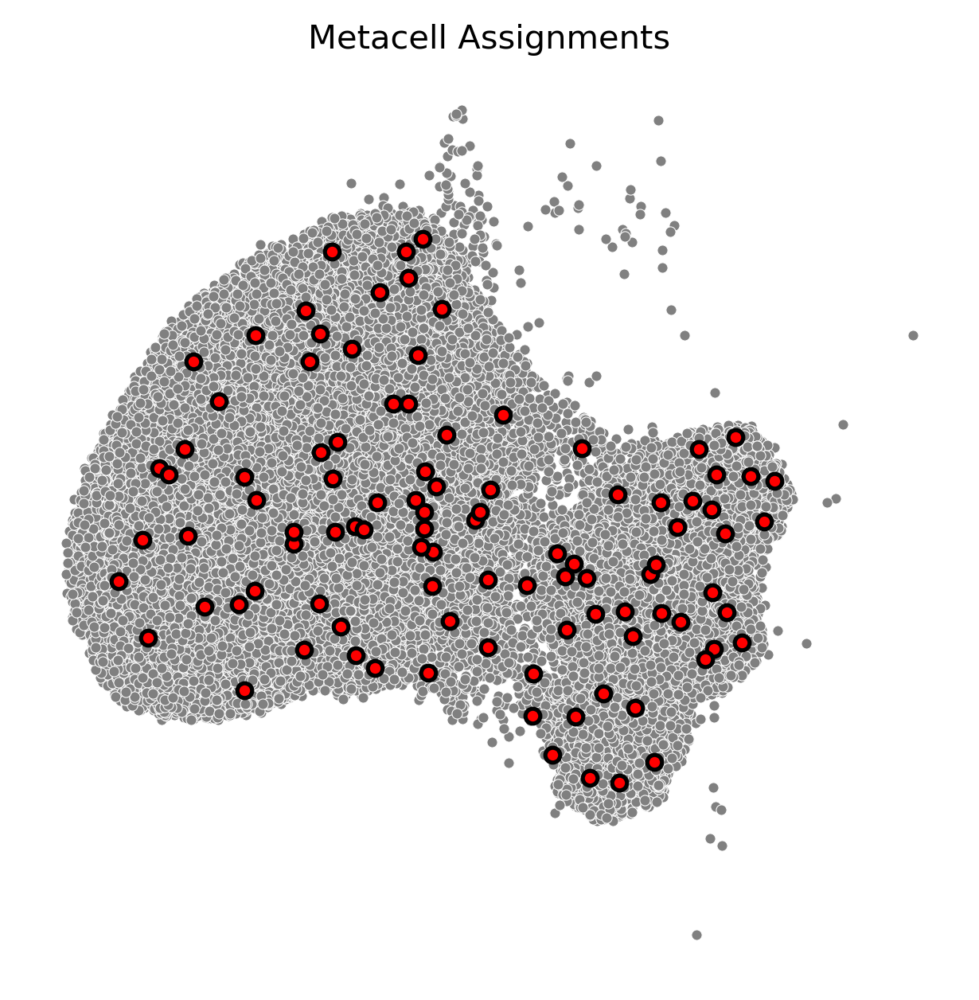

In [31]:
SEACells.plot.plot_2D(adata_fibro, key='X_umap', colour_metacells=False)

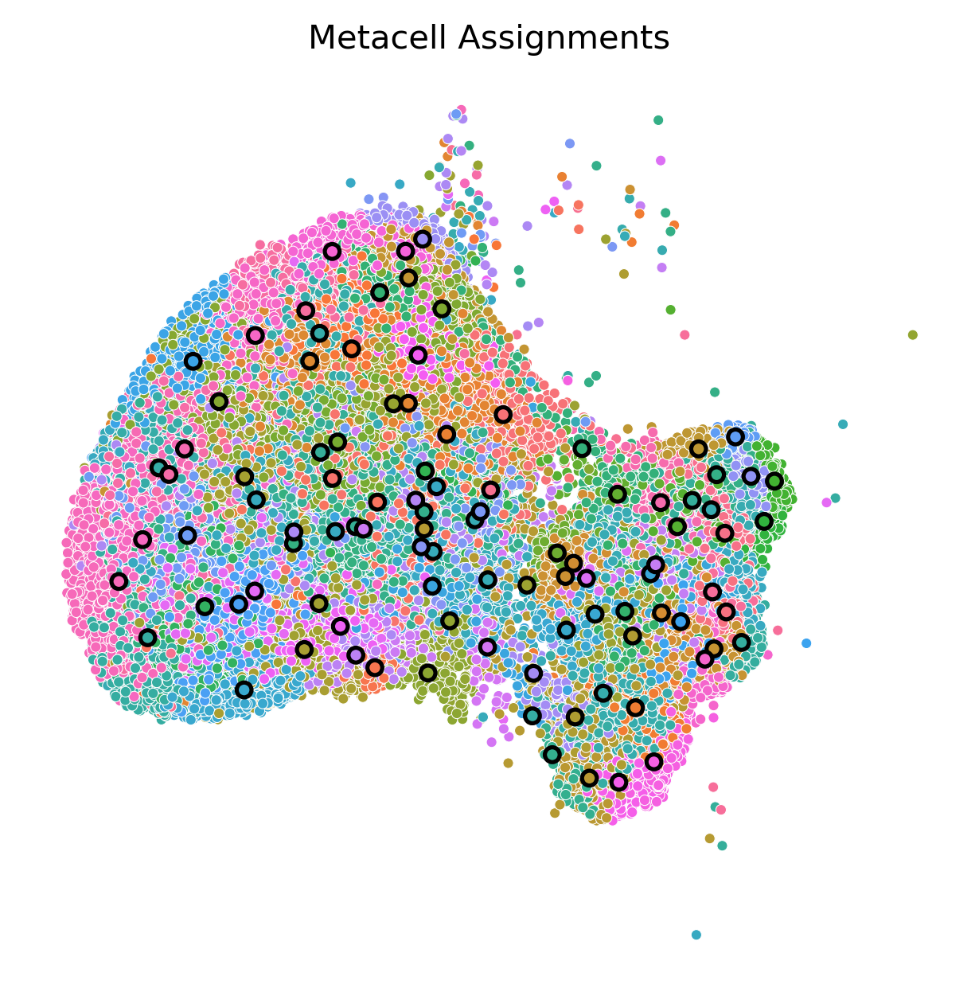

In [32]:
SEACells.plot.plot_2D(adata_fibro, key='X_umap', colour_metacells=True)

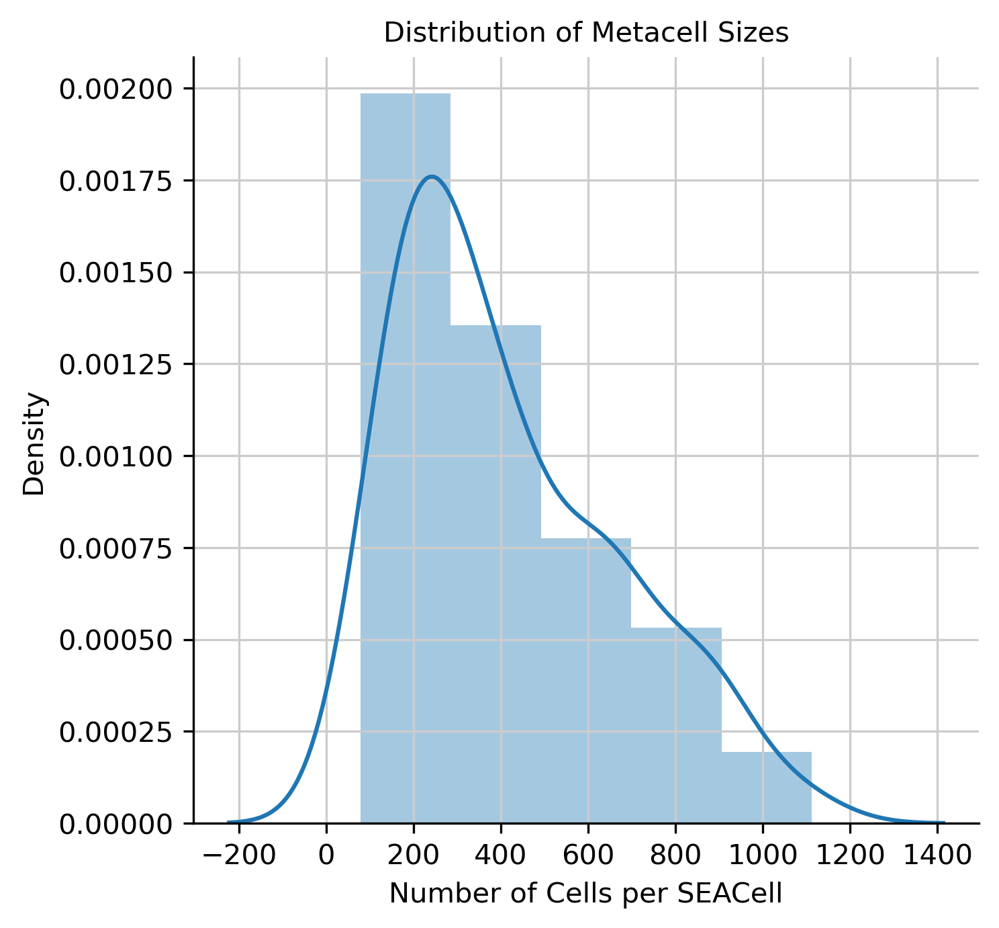

,size
SEACell,
SEACell-0,140
SEACell-1,200
SEACell-10,350
SEACell-11,388
SEACell-12,693
...,...
SEACell-95,298
SEACell-96,467
SEACell-97,547


In [29]:
SEACells.plot.plot_SEACell_sizes(adata_fibro, bins=5)

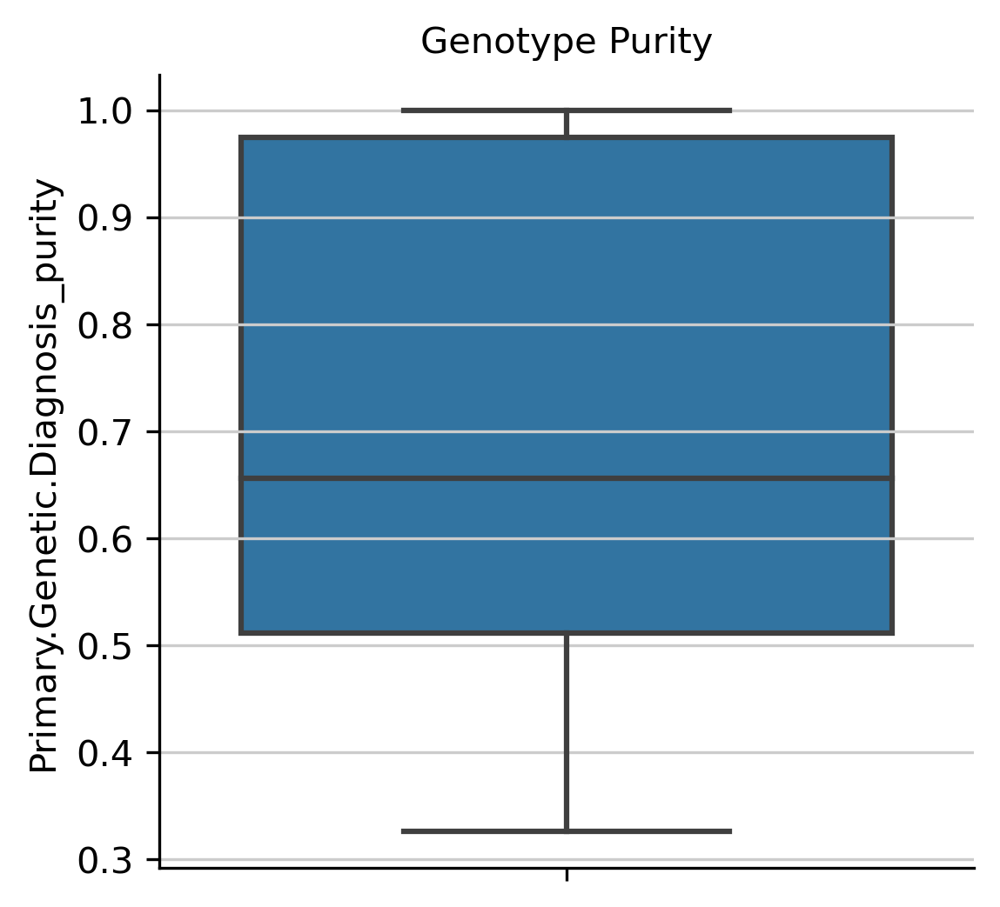

,Primary.Genetic.Diagnosis,Primary.Genetic.Diagnosis_purity
SEACell,,
SEACell-0,control,0.985714
SEACell-1,control,1.000000
SEACell-10,LMNA,0.402857
SEACell-11,RBM20,0.329897
SEACell-12,RBM20,0.458874


In [33]:
SEACell_purity = SEACells.evaluate.compute_celltype_purity(adata_fibro, 'Primary.Genetic.Diagnosis')

plt.figure(figsize=(4,4))
sns.boxplot(data=SEACell_purity, y='Primary.Genetic.Diagnosis_purity')
plt.title('Genotype Purity')
sns.despine()
plt.show()
plt.close()

SEACell_purity.head()

TypeError: 'str' object is not callable

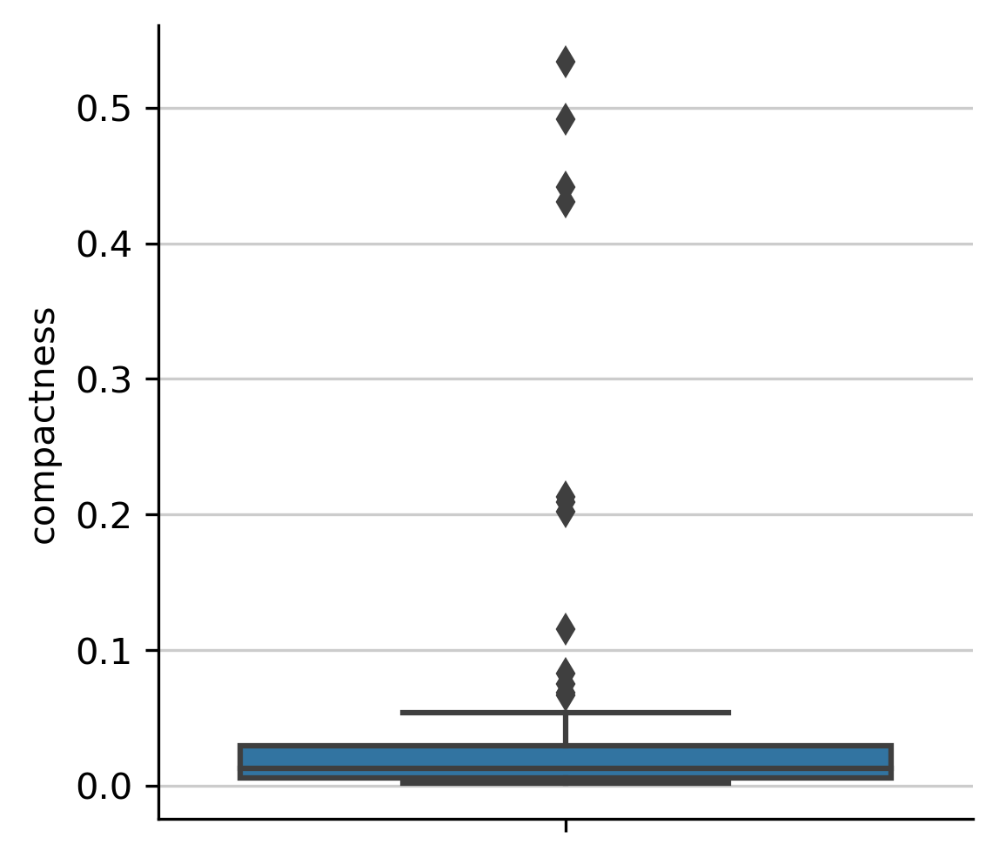

In [91]:
compactness = SEACells.evaluate.compactness(adata_fibro, 'X_FinVAE_25_5')

plt.figure(figsize=(4,4))
sns.boxplot(data=compactness, y='compactness')
plt.title('Compactness')
sns.despine()
plt.show()
plt.close()

compactness.head()

TypeError: 'str' object is not callable

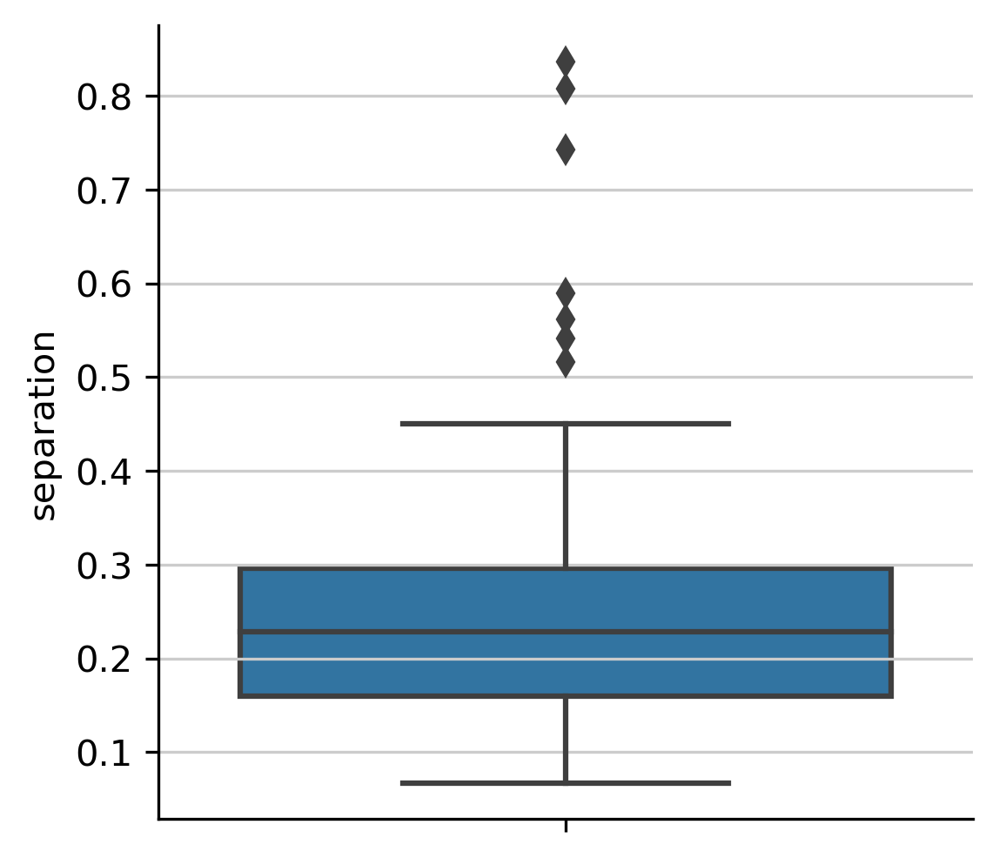

In [92]:
separation = SEACells.evaluate.separation(adata_fibro, 'X_FinVAE_25_5',nth_nbr=1)

plt.figure(figsize=(4,4))
sns.boxplot(data=separation, y='separation')
plt.title('Separation')
sns.despine()
plt.show()
plt.close()

separation.head()

In [104]:
SEACell_soft_ad.write(write_dir+'SEACell_soft_ad_fibro.h5ad')

In [12]:
SEACell_soft_ad = sc.read(write_dir+'SEACell_soft_ad_fibro.h5ad')
adata_fibro = sc.read(write_dir+'adata_fibro_processed.h5ad')

In [34]:
adata_fibro.uns['Primary.Genetic.Diagnosis_colors']= ['plum','peru','cornflowerblue','lightseagreen','#fff400']

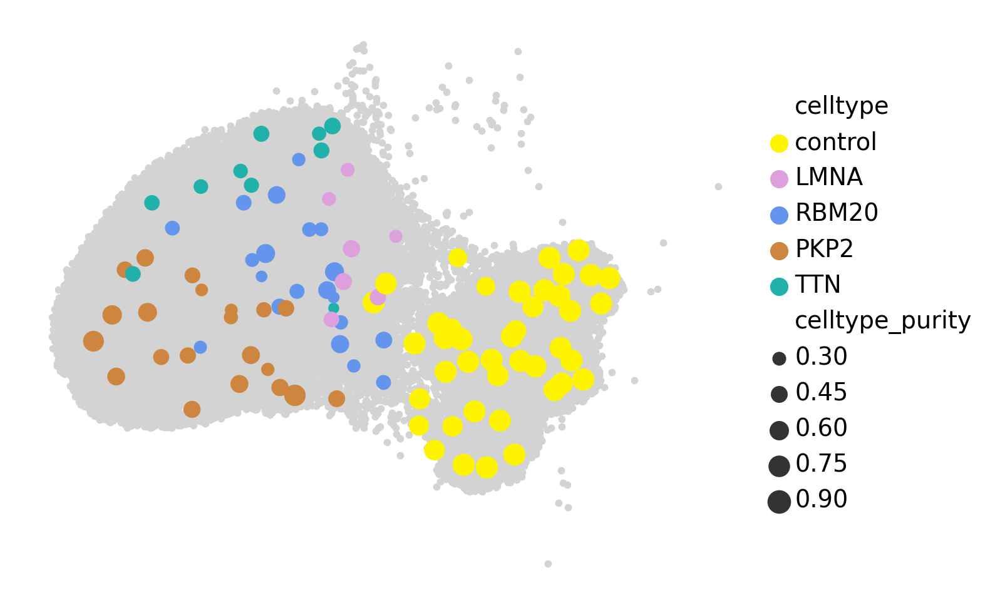

In [35]:
plot_densityWmetacells(adata_fibro,SEACell_soft_ad,plot_basis="X_umap",color='Primary.Genetic.Diagnosis',s=8,palette = ['plum','peru','cornflowerblue','lightseagreen','#fff400'],save_as='heart_fibro_meta_cell.pdf')